### Импортируем требуемые библиотеки и модули

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats import probplot, norm
import plotly.express as px
# import pylab
# import imageio
from sklearn.preprocessing import MinMaxScaler, StandardScaler, RobustScaler, MaxAbsScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import IsolationForest
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from lazypredict.Supervised import LazyRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn import metrics, linear_model
from scipy import stats
from sklearn.metrics import mean_absolute_error, r2_score, mean_squared_error, mean_absolute_percentage_error
from keras.wrappers.scikit_learn import KerasRegressor
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import SGD 
# from PIL import Image
import pickle
import tensorflow as tf
import tensorflow.keras, keras
%matplotlib inline

In [2]:
import absl.logging
absl.logging.set_verbosity(absl.logging.ERROR)

### Загрузим первый файл с данными: "X_bp.xlsx".

In [3]:
df_bp = pd.read_excel('./Base/X_bp.xlsx', index_col='Unnamed: 0')
df_bp.head()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
0,1.86,2030.00,738.74,30.00,22.27,100.00,210.00,70.00,3000.00,220.00
1,1.86,2030.00,738.74,50.00,23.75,284.62,210.00,70.00,3000.00,220.00
2,1.86,2030.00,738.74,49.90,33.00,284.62,210.00,70.00,3000.00,220.00
3,1.86,2030.00,738.74,129.00,21.25,300.00,210.00,70.00,3000.00,220.00
4,2.77,2030.00,753.00,111.86,22.27,284.62,210.00,70.00,3000.00,220.00


Оценим наш датасет

In [4]:
# Размерность (1023 строки, 10 столбцов)
df_bp.shape

(1023, 10)

In [5]:
# Посмотрим описательную статистику
df_bp.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2"
count,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00
mean,2.93,1975.73,739.92,110.57,22.24,285.88,482.73,73.33,2466.92,218.42
std,0.91,73.73,330.23,28.30,2.41,40.94,281.31,3.12,485.63,59.74
min,0.39,1731.76,2.44,17.74,14.25,100.00,0.60,64.05,1036.86,33.80
25%,2.32,1924.16,500.05,92.44,20.61,259.07,266.82,71.25,2135.85,179.63
50%,2.91,1977.62,739.66,110.56,22.23,285.90,451.86,73.27,2459.52,219.20
75%,3.55,2021.37,961.81,129.73,23.96,313.00,693.23,75.36,2767.19,257.48
max,5.59,2207.77,1911.54,198.95,33.00,413.27,1399.54,82.68,3848.44,414.59


In [6]:
df_bp.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1023 entries, 0 to 1022
Data columns (total 10 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       1023 non-null   float64
 1   Плотность, кг/м3                      1023 non-null   float64
 2   модуль упругости, ГПа                 1023 non-null   float64
 3   Количество отвердителя, м.%           1023 non-null   float64
 4   Содержание эпоксидных групп,%_2       1023 non-null   float64
 5   Температура вспышки, С_2              1023 non-null   float64
 6   Поверхностная плотность, г/м2         1023 non-null   float64
 7   Модуль упругости при растяжении, ГПа  1023 non-null   float64
 8   Прочность при растяжении, МПа         1023 non-null   float64
 9   Потребление смолы, г/м2               1023 non-null   float64
dtypes: float64(10)
memory usage: 87.9 KB


### Загрузим второй датасет: "X_nup.xlsx".

In [7]:
df_nup = pd.read_excel('.\Base\X_nup.xlsx', index_col='Unnamed: 0')
df_nup.head()

,"Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,0,4.00,57.00
1,0,4.00,60.00
2,0,4.00,70.00
3,0,5.00,47.00
4,0,5.00,57.00


Посмотрим информацию по нему

In [8]:
df_nup.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1040 entries, 0 to 1039
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Угол нашивки, град  1040 non-null   int64  
 1   Шаг нашивки         1040 non-null   float64
 2   Плотность нашивки   1040 non-null   float64
dtypes: float64(2), int64(1)
memory usage: 32.5 KB


### Объединим эти два датасета. 
Объединение сделаем по индексу (именно для этого мы не удаляли колонку "Unnamed: 0", а сделали ее колонкой индексов), тип объединения INNER.  

In [9]:
df = df_bp.merge(df_nup, left_index=True, right_index=True, how='inner')
df.head()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
0,1.86,2030.00,738.74,30.00,22.27,100.00,210.00,70.00,3000.00,220.00,0,4.00,57.00
1,1.86,2030.00,738.74,50.00,23.75,284.62,210.00,70.00,3000.00,220.00,0,4.00,60.00
2,1.86,2030.00,738.74,49.90,33.00,284.62,210.00,70.00,3000.00,220.00,0,4.00,70.00
3,1.86,2030.00,738.74,129.00,21.25,300.00,210.00,70.00,3000.00,220.00,0,5.00,47.00
4,2.77,2030.00,753.00,111.86,22.27,284.62,210.00,70.00,3000.00,220.00,0,5.00,57.00


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1023 entries, 0 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       1023 non-null   float64
 1   Плотность, кг/м3                      1023 non-null   float64
 2   модуль упругости, ГПа                 1023 non-null   float64
 3   Количество отвердителя, м.%           1023 non-null   float64
 4   Содержание эпоксидных групп,%_2       1023 non-null   float64
 5   Температура вспышки, С_2              1023 non-null   float64
 6   Поверхностная плотность, г/м2         1023 non-null   float64
 7   Модуль упругости при растяжении, ГПа  1023 non-null   float64
 8   Прочность при растяжении, МПа         1023 non-null   float64
 9   Потребление смолы, г/м2               1023 non-null   float64
 10  Угол нашивки, град                    1023 non-null   int64  
 11  Шаг нашивки      

Теперь датасет состоит из 13 колонок и 1023 строчек.

Выведем описательную статистику, в которой:
- count — количество наблюдений
- mean — среднее арифметическое
- std или standard deviation — среднее квадратическое отклонение
- min и max — минимальное и максимальное значения, а также
- 25%, 50% и 75% — первый, второй (он же медиана) и третий квартили.


In [11]:
df.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
count,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00,1023.00
mean,2.93,1975.73,739.92,110.57,22.24,285.88,482.73,73.33,2466.92,218.42,44.25,6.90,57.15
std,0.91,73.73,330.23,28.30,2.41,40.94,281.31,3.12,485.63,59.74,45.02,2.56,12.35
min,0.39,1731.76,2.44,17.74,14.25,100.00,0.60,64.05,1036.86,33.80,0.00,0.00,0.00
25%,2.32,1924.16,500.05,92.44,20.61,259.07,266.82,71.25,2135.85,179.63,0.00,5.08,49.80
50%,2.91,1977.62,739.66,110.56,22.23,285.90,451.86,73.27,2459.52,219.20,0.00,6.92,57.34
75%,3.55,2021.37,961.81,129.73,23.96,313.00,693.23,75.36,2767.19,257.48,90.00,8.59,64.94
max,5.59,2207.77,1911.54,198.95,33.00,413.27,1399.54,82.68,3848.44,414.59,90.00,14.44,103.99


### Посмотрим на количество пропусков, дубликатов и уникальных значений:

In [12]:
df.isnull().sum()

Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
Потребление смолы, г/м2                 0
Угол нашивки, град                      0
Шаг нашивки                             0
Плотность нашивки                       0
dtype: int64

Пропусков не наблюдается

In [13]:
df.duplicated().sum()

0

Дубликатов данный датасет не содержит

In [14]:
df.nunique()

Соотношение матрица-наполнитель         1014
Плотность, кг/м3                        1013
модуль упругости, ГПа                   1020
Количество отвердителя, м.%             1005
Содержание эпоксидных групп,%_2         1004
Температура вспышки, С_2                1003
Поверхностная плотность, г/м2           1004
Модуль упругости при растяжении, ГПа    1004
Прочность при растяжении, МПа           1004
Потребление смолы, г/м2                 1003
Угол нашивки, град                         2
Шаг нашивки                              989
Плотность нашивки                        988
dtype: int64

In [15]:
df['Угол нашивки, град'].unique()

array([ 0, 90], dtype=int64)

In [16]:
df['Угол нашивки, град'].value_counts()

0     520
90    503
Name: Угол нашивки, град, dtype: int64

В столбце "Угол нашивки, град" всего 2 уникальных значения.
Однако мы не будем преобразовывать эти значения в категориальные, потому что градус угла нашивки может быть отличным от 0 и 90 градусов, из-за чего предсказываемый параметр будет менее точным.

## Для построения графиков и диаграмм создадим свою палитру цветов

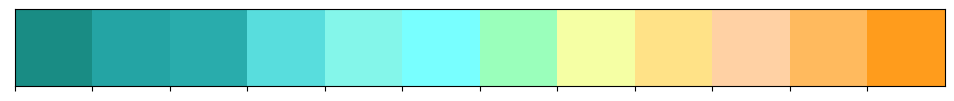

In [17]:
color = ['#198c84', '#24a4a4', '#29acac', '#58dddd', '#84f6ea', '#78ffff', 
         '#9affbb', '#f5ffa4', '#ffe287', '#ffd1a4', '#ffba5e', '#ff9c1c']
sns.set_palette(color)
sns.palplot(sns.color_palette())

### Построим количественную диаграмму значения 'Угол нашивки, град'.

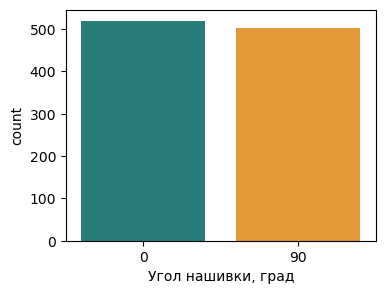

In [18]:
plt.figure(figsize=(4, 3))
sns.set_palette([color[0], color[11]])
sns.countplot(x='Угол нашивки, град', data=df);

Количество значений "0" и "90" градусов примерно одинаковое. Оставим все как есть.

### Проверим данные на "нормальность"

### Построим гистограммы распределения значений.
Гистограмма позволяет представить выборочные данные в графическом виде – в виде столбчатой диаграммы, где данные делятся на заранее определенное количество групп. Вид гистограммы дает наглядное представление функции плотности вероятности некоторой случайной величины, построенной по выборке.

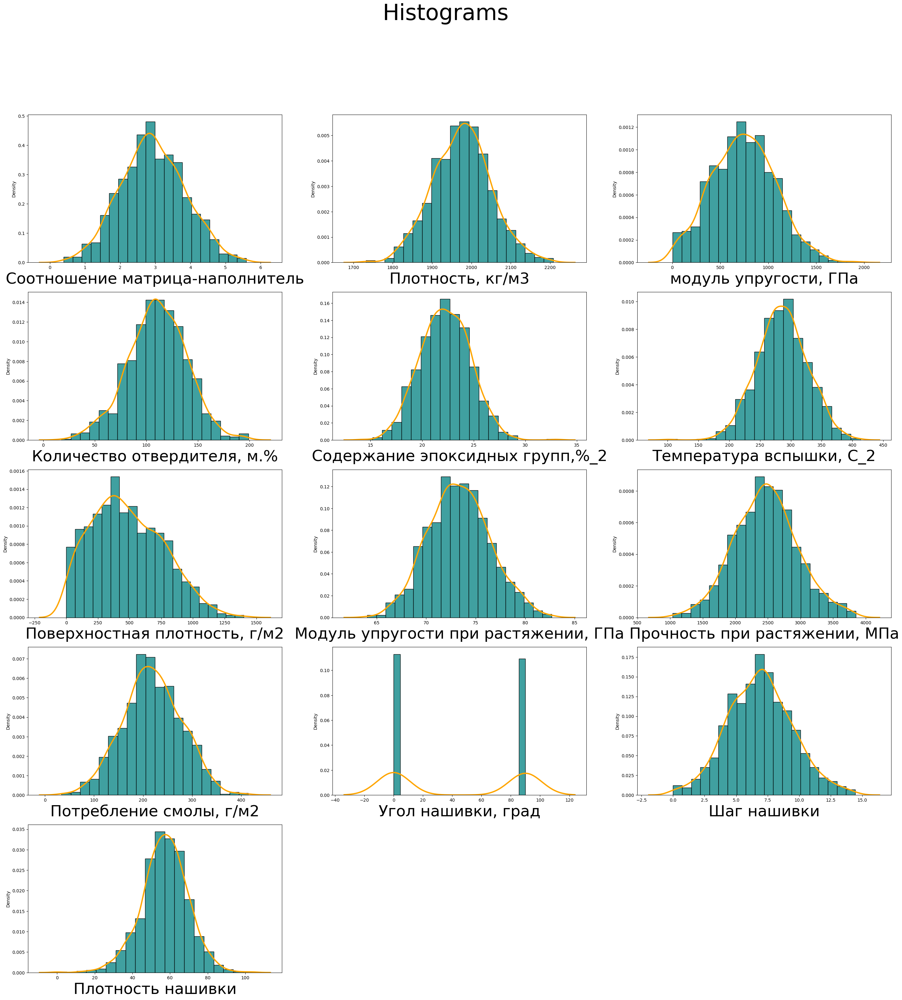

In [19]:
nrows, ncols, col = 5, 3, 1
plt.figure(figsize=(35, 35))
plt.suptitle('Histograms', fontsize=50)
for column in df.columns:
    plt.subplot(nrows, ncols, col)
    sns.histplot(data=df[column], bins=20, stat="density", fill=True, color ='teal')
    sns.kdeplot(df[column], color="orange", linewidth=3)
    plt.xlabel(column, size=35)
    col += 1    

### Графики Q-Q
График QQ («квантиль-квантиль») используется для оценки того, потенциально ли набор данных получен из некоторого теоретического распределения.
Если данные распределены нормально, то точки на графике QQ будут лежать на прямой диагональной линии.

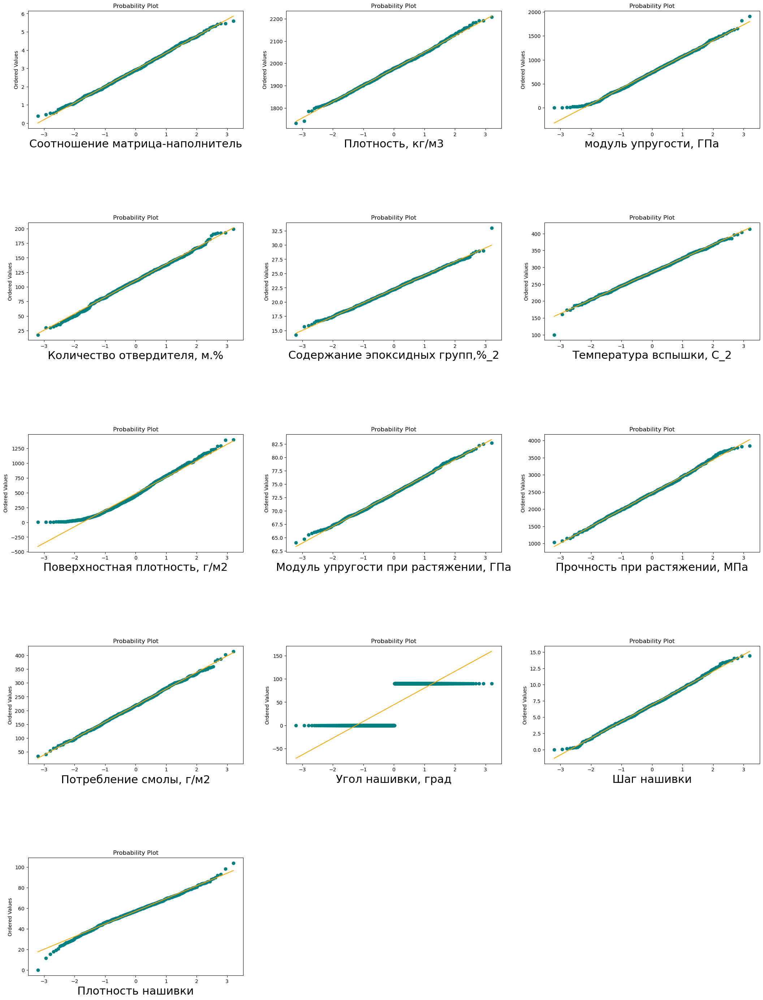

In [20]:
plt.figure(figsize=(30, 30))
nrows, ncols, col = 5, 3, 1
for column in df.columns:
    ax = plt.subplot(nrows, ncols, col)
    probplot(x=df[column], dist='norm', plot=plt)
    plt.legend = column
    plt.xlabel(column, size=22)
    col += 1
    plt.subplots_adjust(right=0.8, top=1, wspace=0.2, hspace=0.8);
    ax.get_lines()[1].set_color('orange')
    ax.get_lines()[0].set_color('teal')
plt.show()

### Тест Шапиро-Уилка.
Тест Шапиро-Уилка - это статистический тест на нормальность. Это количественный метод проверки нормальности. Тест Шапиро-Уилка проверяет нулевую гипотезу о том, что данные были взяты из нормального распределения.

In [21]:
from scipy.stats import shapiro
shapiro_test = []
for i in df.columns:
    if shapiro(df[i])[1] < 0.05:
        shapiro_test.append(i)

print("Not Gaussian:", *shapiro_test, sep='\n') 

Not Gaussian:
модуль упругости, ГПа
Поверхностная плотность, г/м2
Угол нашивки, град
Плотность нашивки


### Тест Д’Агостино и Пирсона.
Этот метод использует асимметрию и эксцесс для проверки нормальности. Нулевая гипотеза для этого теста состоит в том, что распределение основано на нормальном распределении.

In [22]:
from scipy.stats import normaltest
no_normtest = []
for i in df.columns:
    if normaltest(df[i].values, )[1] < 0.05:
        no_normtest.append(i)
        
print("Not Gaussian:", *no_normtest, sep='\n') 

Not Gaussian:
Поверхностная плотность, г/м2
Угол нашивки, град
Плотность нашивки


### Посмотрим на парные диаграммы.
Попарная диаграмма для сравнения распределения пар числовых переменных создаёт сетку точечных диаграмм. Она также содержит гистограмму для каждой функции в диагональных прямоугольниках.

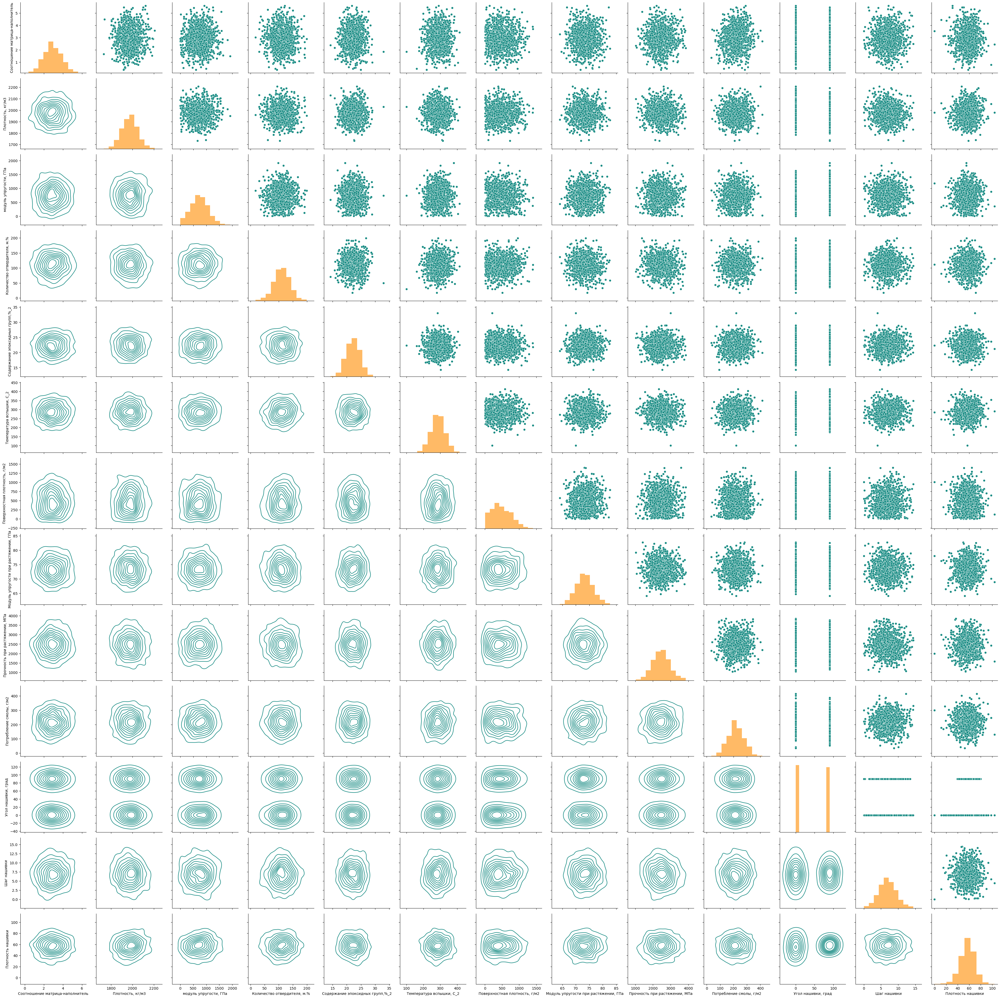

In [23]:
pairplt = sns.PairGrid(data=df, height=3)
pairplt.map_upper(sns.scatterplot)
pairplt.map_diag(plt.hist, alpha=0.6, color='darkorange')
pairplt.map_lower(sns.kdeplot);

### Посмотрим на матрицу корреляции в данных, выясним, насколько наши данные зависят друг от друга.
Корреляционная зависимость — статистическая взаимосвязь двух или более величин, при этом изменения значений одной или нескольких из этих величин сопутствуют систематическому изменению значений другой или других величин.

Матрица корреляций - это квадратная таблица, заголовками строк и столбцов которой являются обрабатываемые переменные, а на пересечении строк и столбцов выводятся коэффициенты корреляции для соответствующей пары признаков.

In [24]:
df.corr();

Для наглядности и простоты восприятия выведем на экран тепловую карту.

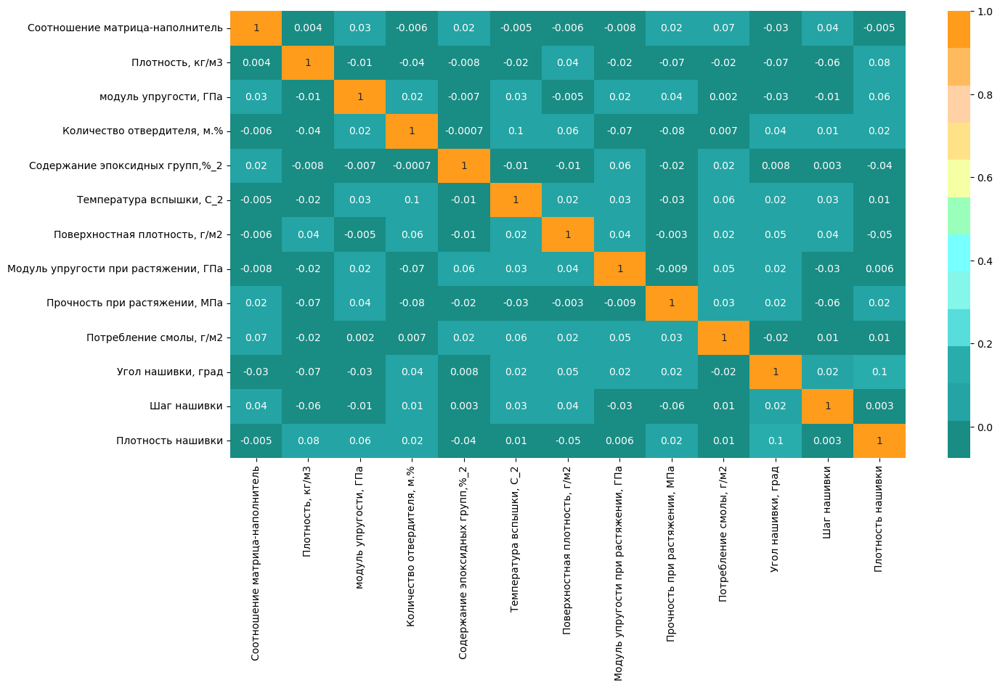

In [25]:
sns.set_palette(color)
plt.figure(figsize=(15, 8))
sns.heatmap(df.corr(), annot=True, fmt='.1g', cmap=color);

Как мы видим, явной корреляции не наблюдается, все показатели около 0. Максимальная корреляций между признаками "Плотность нашивки" и "Угол нашивки, град" равен 0,1. 
Нулевая корреляция означает, что переменные не зависят друг от друга.

## Построим графики "Boxplot"
### Визуализируем выбросы в наших данных. 
Boxplot-это диаграмма, которая показывает, как распределяются значения переменной. Он также известен как график "Ящик с усами" и дает информацию об изменчивости и дисперсии данных, используя сводку из пяти чисел. К ним относятся минимум, первый квартиль (Q1), медиана, третий квартиль (Q3) и максимум.

Для этого напишем функцию вывода на экран сразу нескольких диаграмм.

In [26]:
def boxplots_out(dataframe):
    nrows, ncols, col = 5, 3, 1
    plt.figure(figsize=(35, 30))
    plt.suptitle('Boxplots', fontsize=50)
    for column in dataframe.columns:
        plt.subplot(nrows, ncols, col)
        box_pl = sns.boxplot(data=dataframe, x=dataframe.columns[col-1], color='teal')
        box_pl.set_xlabel(dataframe.columns[col-1], fontsize=21)
        strop_pl = sns.stripplot(data=dataframe, x=dataframe.columns[col-1], color="orange")
        plt.ylabel('')
        plt.xlabel(column, size=30)
        col += 1

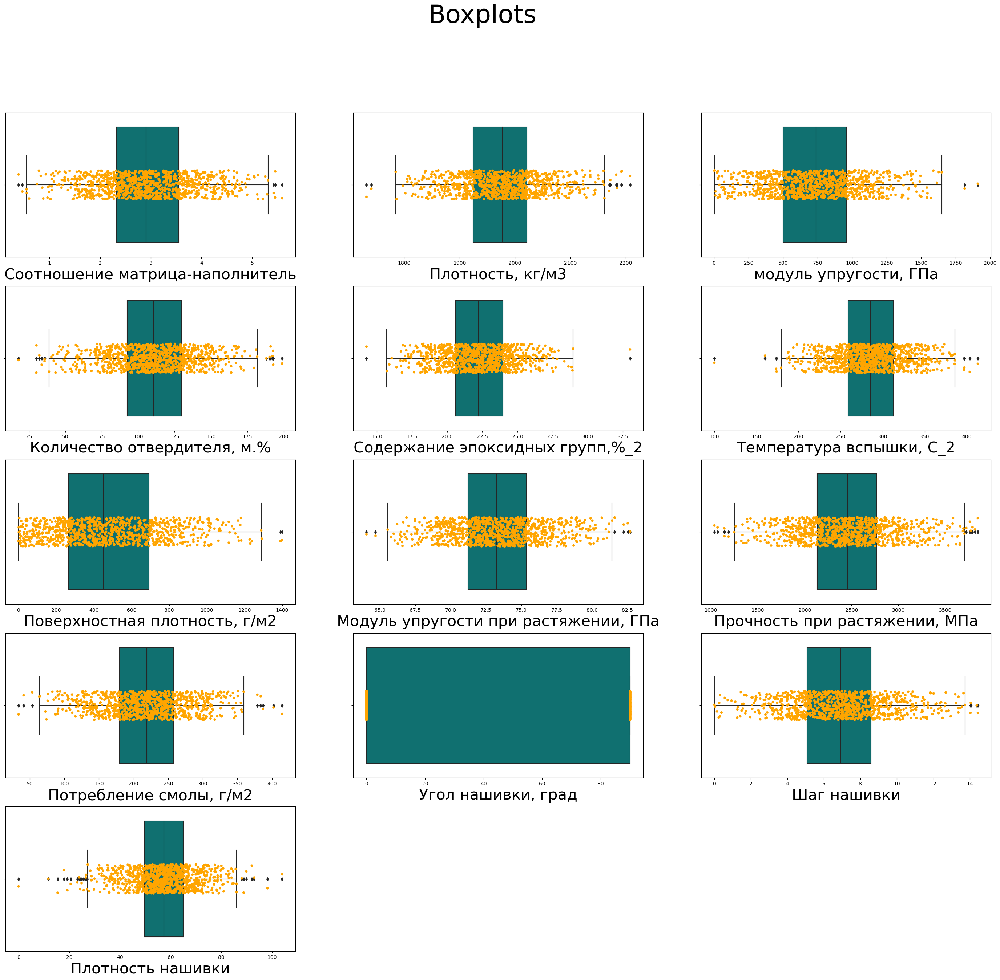

In [27]:
boxplots_out(df);

### В данных присутствуют выбросы. Посмотрим, сколько их.

### IQR 
Довольно распространенным способом выявления и удаления выбросов является правило
1.5 * IQR. В стандартном нормальном распределении Q1 и Q3 соответствуют
-0.6745 и 0.6745.
Напишем функцию для нахождения и удаления выбросов.

In [28]:
def iqr(dataframe):
    q1 = -0.6745
    q3 = 0.6745
    iqr = q3 - q1
    lower_bound = q1 - (1.5 * iqr)
    upper_bound = q3 + (1.5 * iqr)
    # найдем границы 1.5 * IQR по каждому столбцу
    Q1 = dataframe.quantile(0.25)
    Q3 = dataframe.quantile(0.75)
    IQR = Q3 - Q1
    lower, upper = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR
    # создадим маску для выбросов
    # (если хотя бы один выброс в строке (True), метод .any() сделает всю строку True
    mask_out = ((dataframe < lower) | (dataframe > upper)).any(axis=1)
    # найдем выбросы во всем датафрейме
    out = dataframe[mask_out].shape
    return out

In [29]:
iqr(df)

(87, 13)

Думаю, что 87 выбросов - не так много, поэтому строки, которые содержат выбросы, мы можем удалить.

In [30]:
def mask_no_out(dataframe):
    q1, q3 = -0.6745, 0.6745
    iqr = q3 - q1
    lower_bound, upper_bound = q1 - (1.5 * iqr), q3 + (1.5 * iqr)
    Q1, Q3 = dataframe.quantile(0.25), dataframe.quantile(0.75)
    IQR = Q3 - Q1
    lower, upper = Q1 - 1.5 * IQR, Q3 + 1.5 * IQR
    mask_no_out = ((dataframe >= lower) & (dataframe <= upper)).all(axis=1)
    df = pd.DataFrame(dataframe[mask_no_out])
    return df

In [31]:
data = mask_no_out(df)
data.shape

(936, 13)

### Еще раз посмотрим на выбросы на графиках "Boxplot":

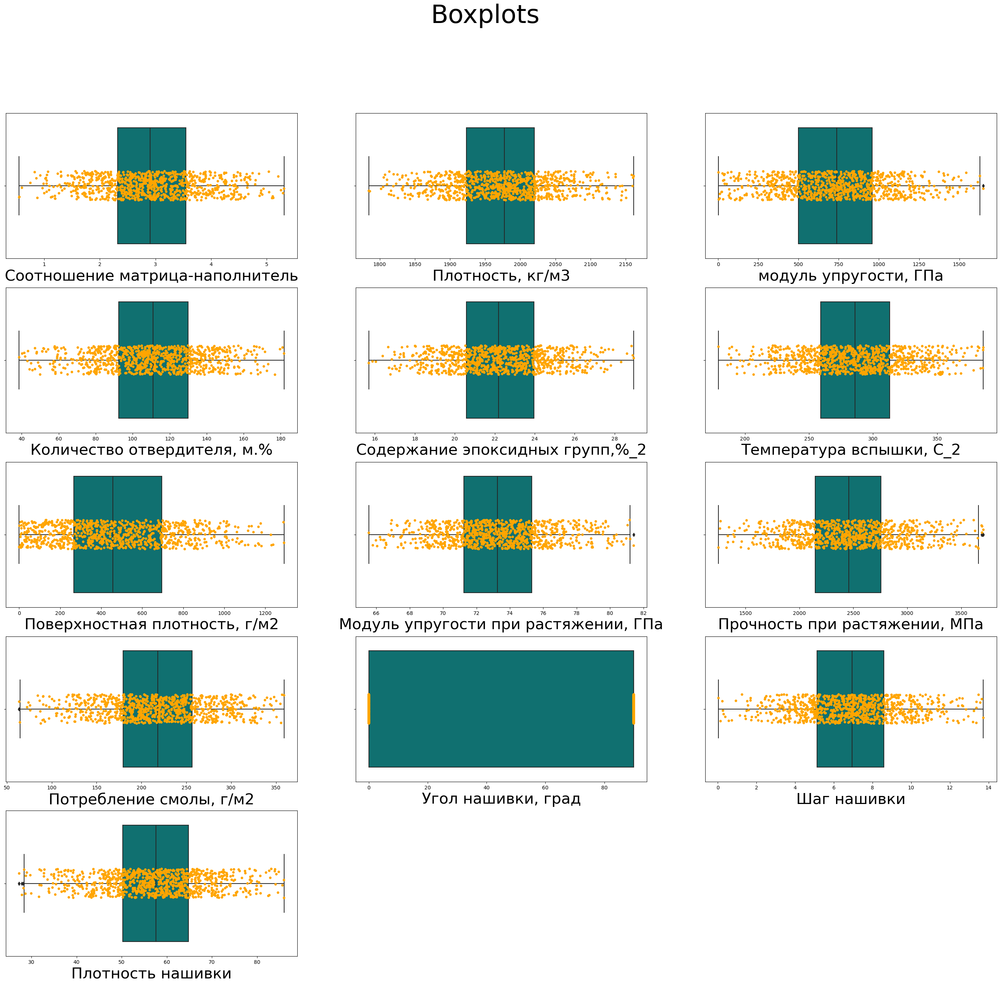

In [32]:
boxplots_out(data)

Выбросы все еще присутствуют в наших данных. Посмотрим, сколько их.

In [33]:
iqr(data)

(10, 13)

Наблюдаем еще 10 строк с выбросами. Удалим их.

In [34]:
data = mask_no_out(data)
data.shape

(926, 13)

Посмотрим на графики "Boxlot":

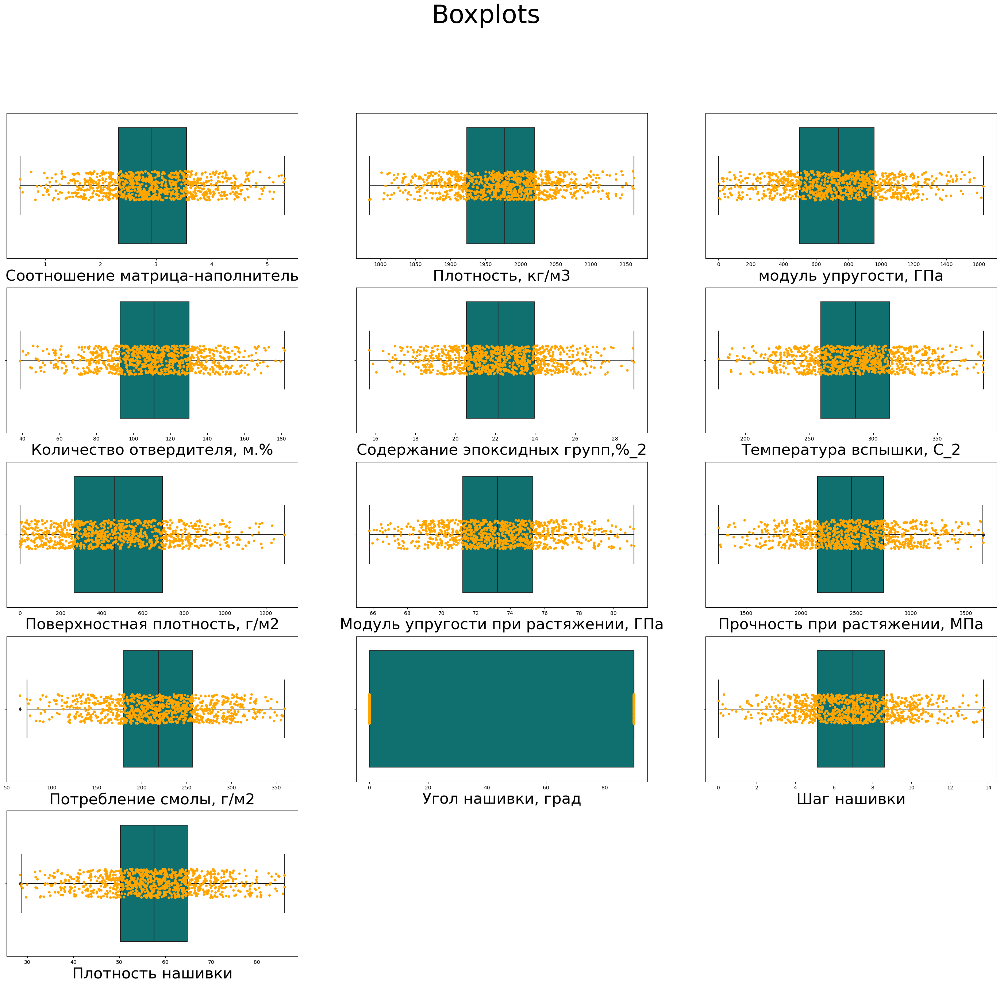

In [35]:
boxplots_out(data)

Все еще остались выбросы. Отобразим их количество.

In [36]:
iqr(data)

(4, 13)

4 выброса. Удалим их.

In [37]:
data = mask_no_out(data)
data.shape

(922, 13)

Посмотрим снова на графики "Boxplot":

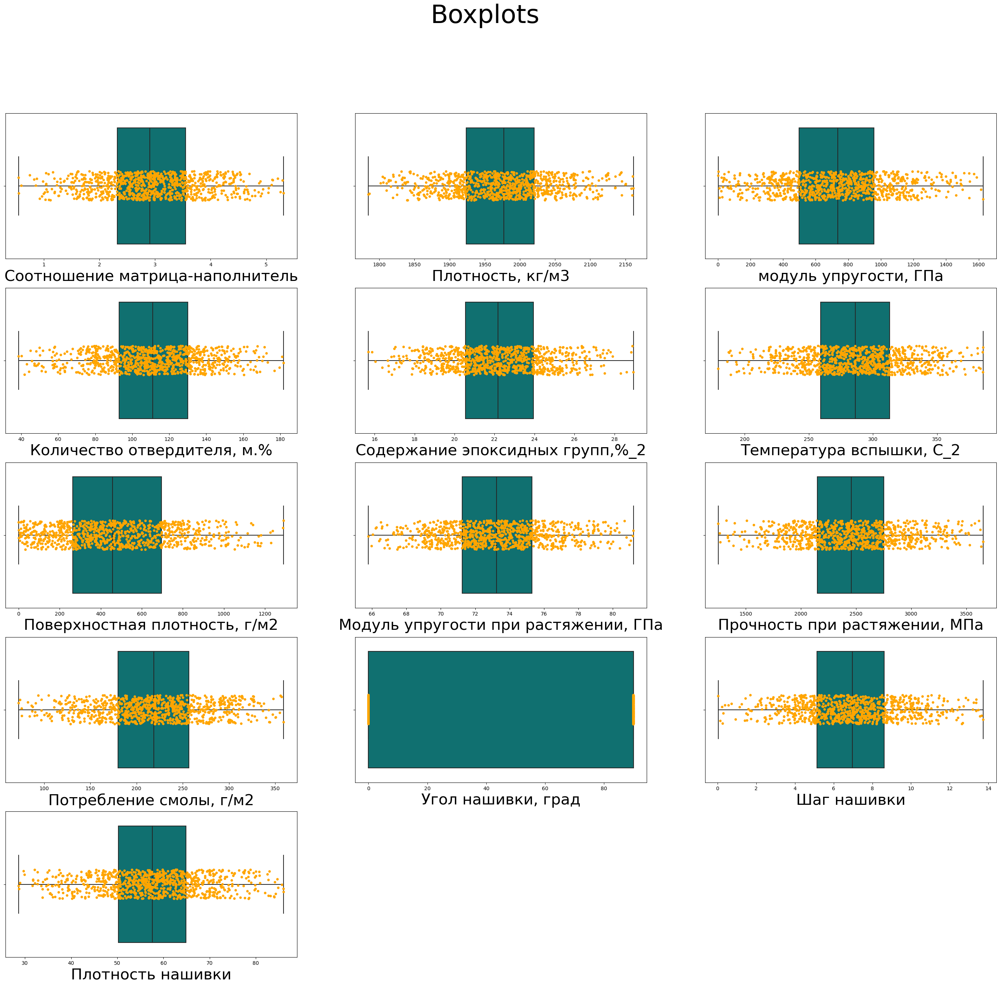

In [38]:
boxplots_out(data)

Визуально выбросов на графиках не видно. 
Посмотрим, верны ли наши предположения:

In [39]:
iqr(data)

(0, 13)

Сохраним преобразованный датасет без выбросов в отдельную папку с данными.

In [40]:
data.to_excel('.\Base\df_merge.xlsx')

Выведем описательную статистику для очищенного от выбросов датасета.

In [41]:
data.describe()

,Соотношение матрица-наполнитель,"Плотность, кг/м3","модуль упругости, ГПа","Количество отвердителя, м.%","Содержание эпоксидных групп,%_2","Температура вспышки, С_2","Поверхностная плотность, г/м2","Модуль упругости при растяжении, ГПа","Прочность при растяжении, МПа","Потребление смолы, г/м2","Угол нашивки, град",Шаг нашивки,Плотность нашивки
count,922.00,922.00,922.00,922.00,922.00,922.00,922.00,922.00,922.00,922.00,922.00,922.00,922.00
mean,2.93,1974.12,736.12,111.14,22.20,286.18,482.43,73.30,2461.49,218.05,45.98,6.93,57.56
std,0.90,71.04,327.61,26.75,2.39,39.42,280.44,3.03,453.56,57.14,45.01,2.51,11.12
min,0.55,1784.48,2.44,38.67,15.70,179.37,0.60,65.79,1250.39,72.53,0.00,0.04,28.66
25%,2.32,1923.32,498.54,92.86,20.56,259.21,264.35,71.24,2148.18,179.88,0.00,5.14,50.28
50%,2.91,1977.32,736.18,111.16,22.18,286.22,457.73,73.25,2455.97,218.70,90.00,6.97,57.58
75%,3.55,2020.05,956.96,130.11,23.96,313.01,695.53,75.31,2751.23,256.62,90.00,8.61,64.84
max,5.31,2161.57,1628.00,181.83,28.96,386.07,1291.34,81.20,3654.43,359.05,90.00,13.73,86.01


### Повторно посмотрим на парные диаграммы

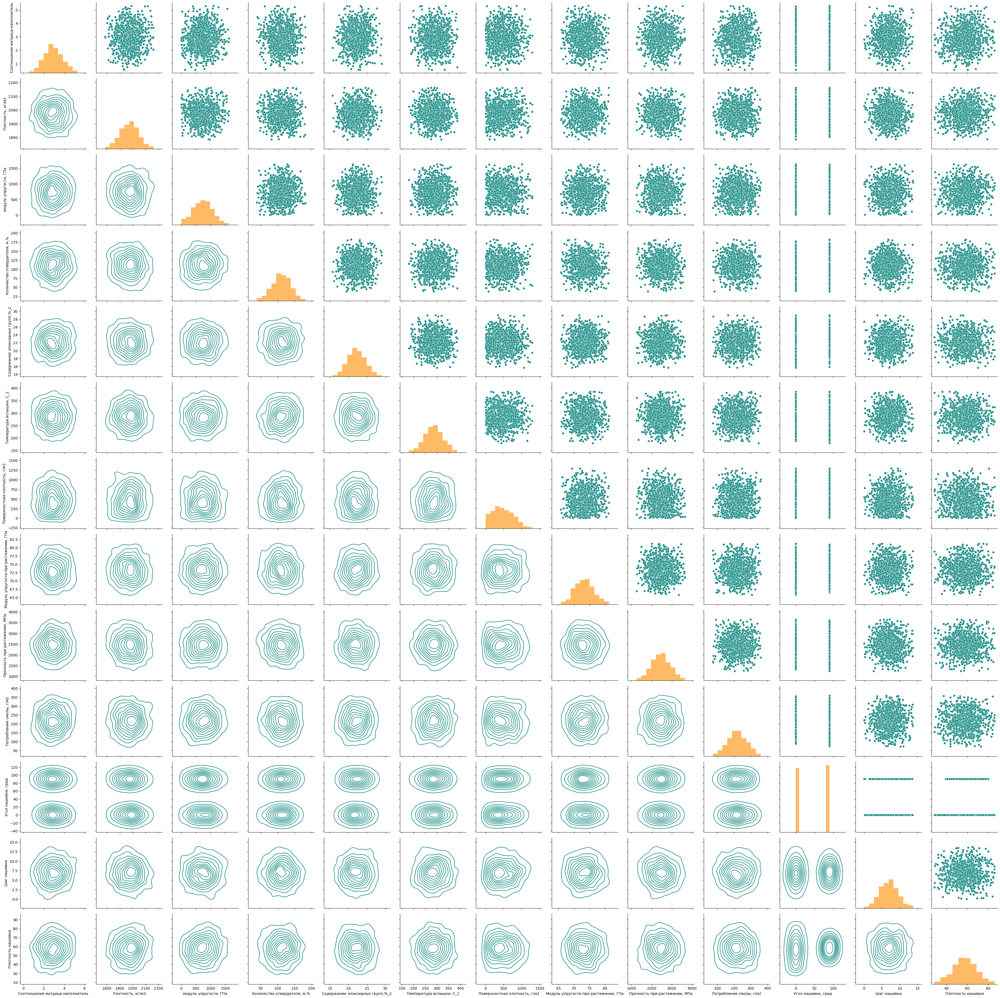

In [42]:
pairplt = sns.PairGrid(data=data, height=3)
pairplt.map_upper(sns.scatterplot)
pairplt.map_diag(plt.hist, alpha=0.6, color='darkorange')
pairplt.map_lower(sns.kdeplot);

Никаких взаимосвязей не наблюдается.

### Посмотрим еще раз на тепловую карту корреляции

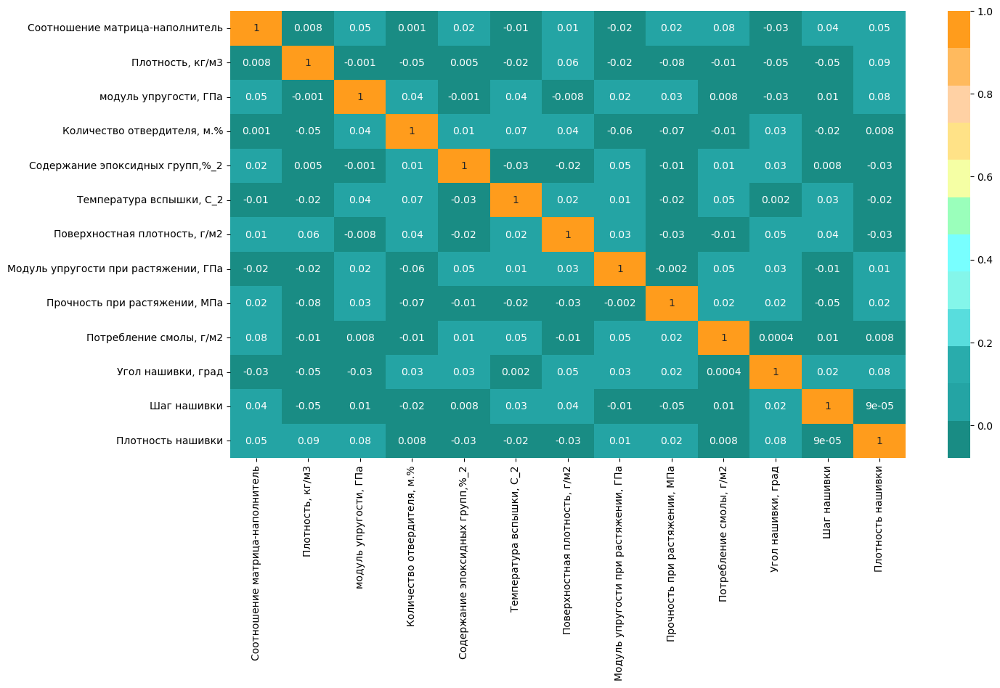

In [43]:
plt.figure(figsize=(15, 8))
sns.heatmap(data.corr(), annot=True, fmt='.1g', cmap=color);

Корреляция стала еще хуже.

Выведем на экран список колонок из датасета.

In [44]:
data.columns

Index(['Соотношение матрица-наполнитель', 'Плотность, кг/м3',
       'модуль упругости, ГПа', 'Количество отвердителя, м.%',
       'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2',
       'Поверхностная плотность, г/м2', 'Модуль упругости при растяжении, ГПа',
       'Прочность при растяжении, МПа', 'Потребление смолы, г/м2',
       'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки'],
      dtype='object')

# Обучение и оценка моделей

### Выделим столбцы, на которых будем проводить обучение, и признаки, которые будем предсказывать.

In [45]:
X_no_norm = data[['Соотношение матрица-наполнитель', 'Плотность, кг/м3',
                  'модуль упругости, ГПа', 'Количество отвердителя, м.%',
                  'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2',
                  'Поверхностная плотность, г/м2',
                  'Потребление смолы, г/м2', 'Угол нашивки, град',
                  'Шаг нашивки', 'Плотность нашивки']]

y_1 = data['Модуль упругости при растяжении, ГПа']
y_2 = data['Прочность при растяжении, МПа']

Посмотрим размерность.

In [46]:
X_no_norm.shape, y_1.shape, y_2.shape

((922, 11), (922,), (922,))

11 столбцов, на которых будем проводить обучение;

2 признака, значения которых будем предсказывать.

## Напишем необходимые функции для обучения моделей и введем константы.

In [47]:
cv, n_jobs, verbose, random_state, n_iter = 10, -1, 10, 18, 10
score_y1, score_y2 = [], []

In [48]:
model_lin_reg = LinearRegression() # Линейная регрессия
model_k_neig_regr = KNeighborsRegressor() # Метод ближайших соседей
model_rf = RandomForestRegressor() # Случайный лес
model_svr = SVR() # Метод опорных векторов
model_gbr = GradientBoostingRegressor() # Градиентный бустинг

In [49]:
pipe_lr = Pipeline(steps=[('scaler', StandardScaler()),
                    ('lr', model_lin_reg)])
pipe_knn = Pipeline(steps=[('scaler', StandardScaler()),
                           ('knn', model_k_neig_regr)])
pipe_rf = Pipeline(steps=[('scaler', StandardScaler()),
                    ('rf', model_rf)])
pipe_svr = Pipeline(steps=[('scaler', StandardScaler()),
                     ('svr', model_svr)])
pipe_gbr = Pipeline(steps=[('scaler', StandardScaler()),
                     ('gbr', model_gbr)])

In [50]:
linreg_params = [
    {'scaler': [StandardScaler(), RobustScaler(), MinMaxScaler(feature_range=(0, 1)), MaxAbsScaler()],
     'lr__fit_intercept' : ['True', 'False']}]

knn_params = [
    {'scaler': [StandardScaler(), RobustScaler(), MinMaxScaler(feature_range=(0, 1)), MaxAbsScaler()],
     'knn__n_neighbors' : range(1, 51, 2), 
     'knn__weights' : ['uniform', 'distance'],
     'knn__algorithm' : ['auto', 'ball_tree', 'kd_tree', 'brute']}]

rf_params = [
    {'scaler': [StandardScaler(), RobustScaler(), MinMaxScaler(feature_range=(0, 1)), MaxAbsScaler()],
     'rf__n_estimators' : range(10, 500, 10),
     'rf__criterion' : ['squared_error', 'absolute_error', 'poisson'],
     'rf__max_depth' : range(1, 201, 10),
     'rf__max_features' : ['sqrt', 'log2', None]}]

svr_params = [
   {'scaler': [StandardScaler(), RobustScaler(), MinMaxScaler(feature_range=(0, 1)), MaxAbsScaler()],
     'svr__C' : range(1, 201, 10),
     'svr__gamma': [1, 0.1, 0.01],
     'svr__kernel': ['linear', 'poly', 'rbf', 'sigmoid']}]

gbr_params = [
    {'scaler': [StandardScaler(), RobustScaler(), MinMaxScaler(feature_range=(0, 1)), MaxAbsScaler()],
     'gbr__learning_rate': [0.01,0.02,0.03,0.04],
     'gbr__subsample'    : [0.9, 0.5, 0.2, 0.1],
     'gbr__n_estimators' : [100,500,1000, 1500],
     'gbr__max_depth'    : [4,6,8,10]}]

### GridSearchCV. Поиск по сетке.
При выполнении оптимизации гиперпараметров сначала необходимо определить область или сетку параметров, в которую мы включаем набор возможных значений гиперпараметров, которые могут быть использованы для построения модели.

Затем используется метод поиска по сетке для размещения этих гиперпараметров в матрице, и модель обучается на каждой комбинации значений гиперпараметров.

После этого выбирается модель с наилучшими показателями.

In [51]:
def grid_search(pipe, param_grid):
    model_grid_search = GridSearchCV(estimator=pipe, 
                                     param_grid=param_grid,
                                     n_jobs=n_jobs,
                                     cv=cv)
    model_grid_search.fit(X_train, y_train)
    print(model_grid_search.best_params_)
    scaler = model_grid_search.best_estimator_['scaler']
    best_estimator = model_grid_search.best_estimator_
    y_pred = best_estimator.predict(X_test)
    print(model_grid_search.score(X_test, y_test))
    return y_pred, scaler

### RandomizedSearchCV. Случайный поиск.

В то время как поиск по сетке рассматривает все возможные комбинации гиперпараметров, чтобы найти лучшую модель, случайный поиск выбирает и тестирует только случайную комбинацию гиперпараметров.

Вместо исчерпывающего поиска делает случайную выборку из сетки гиперпараметров.

Мы указываем общее количество попыток случайного поиска, прежде чем будет получена наилучшая модель.

In [52]:
def random_search(pipe, param_rand):
    model_random_search = RandomizedSearchCV(pipe, 
                                             param_rand, 
                                             n_jobs=n_jobs,
                                             cv=cv,
                                             n_iter=n_iter,
                                             verbose=verbose, 
                                             random_state=random_state)
    model_random_search.fit(X_train, y_train)
    print(model_random_search.best_params_)
    scaler = model_random_search.best_estimator_['scaler']
    best_estimator = model_random_search.best_estimator_
    y_pred = best_estimator.predict(X_test)
    print(model_random_search.score(X_test, y_test))
    return y_pred, scaler, best_estimator

### Функция для вывода на экран сравнительной таблицы актуальных и предсказанных значений
(первые 5 значений)

In [53]:
def comp_res(y_pred):
    result = ({'Actual': y_test, 'Predicted': y_pred.flatten()})
    return pd.DataFrame(result).head()

### Функция отображения сравнительных графиков.

In [54]:
def diagnostics(y_test, y_pred, scaler):
    y_test_y = y_test.reset_index(drop=True)
    plt.figure(figsize=(20, 5))
    plt.suptitle(scaler, fontsize=22)
    plt.subplot(1, 2, 1)
    sns.histplot(X_no_norm);
    plt.xlabel('До преобразования', size=15)
    plt.subplot(1, 2, 2)
    sns.histplot(pd.DataFrame(scaler.fit_transform(X_no_norm), columns=X_no_norm.columns));
    plt.xlabel('После преобразования', size=15);
    
    fig = plt.figure(figsize=(16, 5))
    # сравним распределение истинной и прогнозной целевой переменных
    plt.subplot(1,3,(1, 2));
    plt.title("Тестовые и прогнозные значения")
    plt.plot(y_test_y, label = "Тест", color = 'teal')
    plt.plot(y_pred, label="Прогноз", color = 'orange')
    plt.xlabel('Количество наблюдений')
    plt.ylabel('y_true and y_pred')
    plt.grid(True);    
        
    plt.subplot(1,3,3);
    plt.title('Тестовые и прогнозные значения')
    sns.kdeplot(y_test_y, fill=True, label="Тест", color='teal')
    sns.kdeplot(y_pred, fill=True, label="Прогноз", color='orange')
    plt.xlabel('y_true and y_pred')
    fig.legend()
    fig.show()

### Функция отображения графиков для нейронных сетей

In [55]:
def diagnostics_nn(y_test, y_pred):
    y_test_y = y_test.reset_index(drop=True)
    fig = plt.figure(figsize=(16, 5))
    # сравним распределение истинной и прогнозной целевой переменных
    plt.subplot(1,3,(1, 2));
    plt.title("Тестовые и прогнозные значения")
    plt.plot(y_test_y, label = "Тест", color = 'teal')
    plt.plot(y_pred, label="Прогноз", color = 'orange')
    plt.xlabel('Количество наблюдений')
    plt.ylabel('y_true and y_pred')
    plt.grid(True);    
        
    plt.subplot(1,3,3);
    plt.title('Тестовые и прогнозные значения')
    sns.kdeplot(y_test_y, fill=True, label="Тест", color='teal')
    sns.kdeplot(y_pred, fill=True, label="Прогноз", color='orange')
    plt.xlabel('y_true and y_pred')
    fig.legend()
    # plt.show()

### Функция для вывода на печать сравнительной таблицы

In [56]:
def comp_res(y_pred):
    return pd.DataFrame({'Actual': y_test, 'Predicted': y_pred.flatten()}).head()

### Функция оценки работы модели.

In [57]:
def print_score(y_test, y_pred, score):
    # Коэффициент детерминации R2
    print('R2:', np.round(metrics.r2_score(y_test, y_pred), 3))
    score.append(np.round(metrics.r2_score(y_test, y_pred), 4))

    # Средняя квадратическая ошибка MSE
    print('MSE:', np.round(mean_squared_error(y_test, y_pred), 3))
    score.append(np.round(mean_squared_error(y_test, y_pred), 4))

    # Корень средней квадратической ошибки
    print('RMSE:', np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 3))
    score.append(np.round(np.sqrt(mean_squared_error(y_test, y_pred)), 4))

    # Средняя абсолютная ошибка
    print('MAE:', np.round(mean_absolute_error(y_test, y_pred), 3))
    score.append(np.round(mean_absolute_error(y_test, y_pred), 4))

    # Средняя абсолютная ошибка в процентах (mean absolute percentage error)
    print('MAPE:', np.round(mean_absolute_percentage_error(y_test, y_pred), 3))
    score.append(np.round(mean_absolute_percentage_error(y_test, y_pred), 4))

## Разобьем данные на обучающую и тестовую выборки.

In [58]:
X_train, X_test, y_train, y_test = train_test_split(X_no_norm, y_1,
                                                    test_size=0.3,
                                                    shuffle=True,
                                                    random_state=18)

In [59]:
# размерность обучающей
print(X_train.shape, y_train.shape)

# и тестовой выборки
print(X_test.shape, y_test.shape)

(645, 11) (645,)
(277, 11) (277,)


# Предскажем "Модуль упругости при растяжении, ГПа"

## LinearRegression
"Модуль упругости при растяжении, ГПа"

Обучим модель и выведем наилучшие параметры по GridSearchCV

In [60]:
y_pred_lr = grid_search(pipe_lr, linreg_params)

{'lr__fit_intercept': 'True', 'scaler': MinMaxScaler()}
-0.026739052457467105


Выведем сравнительную таблицу первых 5 значений.

In [61]:
comp_res(y_pred_lr[0])

,Actual,Predicted
69,69.53,73.54
420,75.73,73.01
180,72.15,73.27
681,70.43,72.50
972,74.77,72.99


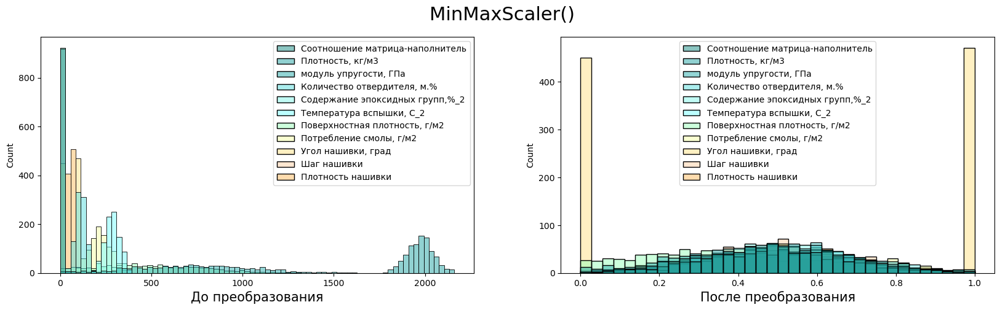

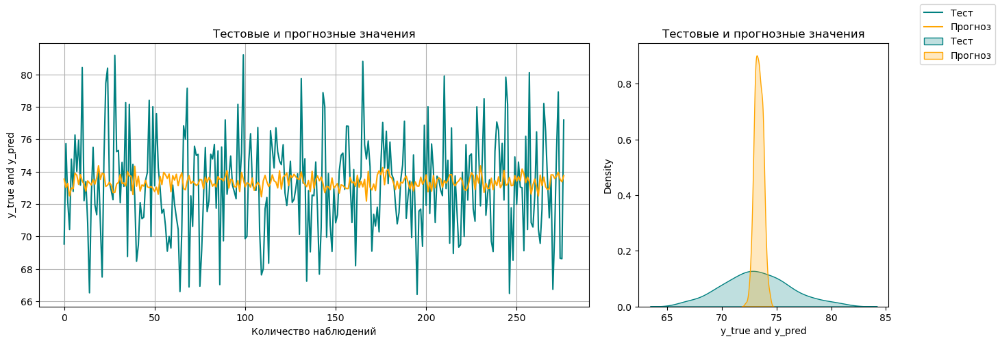

In [62]:
diagnostics(y_test, y_pred_lr[0], y_pred_lr[1])

In [63]:
print_score(y_test, y_pred_lr[0], score_y1)

R2: -0.027
MSE: 9.71
RMSE: 3.116
MAE: 2.483
MAPE: 0.034


# KNeighborsRegressor (метод ближайших соседей)
"Модуль упругости при растяжении, ГПа"

Обучим модель и выведем наилучшие параметры по GridSearchCV

In [64]:
y_pred_rnn = grid_search(pipe_knn, knn_params)

{'knn__algorithm': 'auto', 'knn__n_neighbors': 43, 'knn__weights': 'uniform', 'scaler': MinMaxScaler()}
-0.011869076356469055


Выведем сравнительную таблицу первых 5 значений.

In [65]:
comp_res(y_pred_rnn[0])

,Actual,Predicted
69,69.53,73.27
420,75.73,73.08
180,72.15,72.94
681,70.43,72.68
972,74.77,73.56


Построим сравнительные графики.

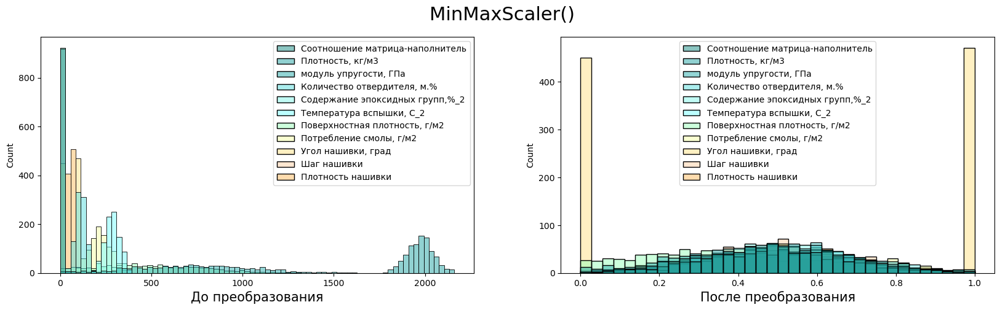

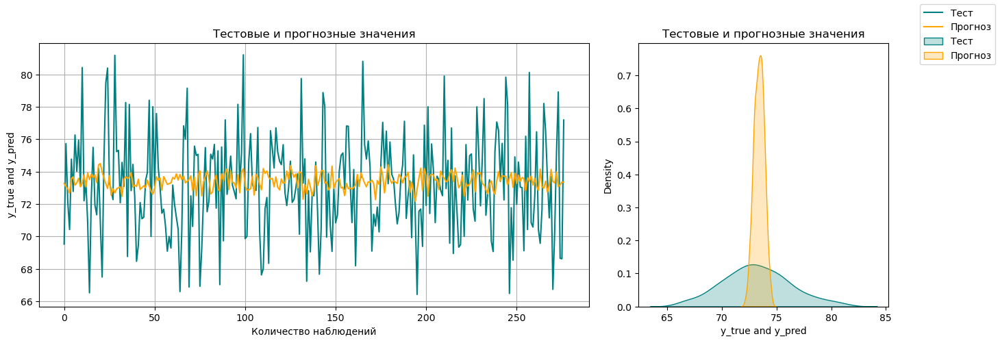

In [66]:
diagnostics(y_test, y_pred_rnn[0], y_pred_rnn[1])

Оценка модели.

In [67]:
print_score(y_test, y_pred_rnn[0], score_y1)

R2: -0.012
MSE: 9.57
RMSE: 3.094
MAE: 2.483
MAPE: 0.034


# Random Forest
"Модуль упругости при растяжении, ГПа"

Обучим модель и выведем наилучшие параметры по RandomSearchCV

In [68]:
y_pred_rf = random_search(pipe_rf, rf_params)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
{'scaler': MaxAbsScaler(), 'rf__n_estimators': 460, 'rf__max_features': 'sqrt', 'rf__max_depth': 61, 'rf__criterion': 'absolute_error'}
-0.0458004184485965


Выведем сравнительную таблицу первых 5 значений.

In [69]:
comp_res(y_pred_rf[0])

,Actual,Predicted
69,69.53,74.10
420,75.73,73.52
180,72.15,73.42
681,70.43,72.57
972,74.77,72.57


Построим сравнительные графики.

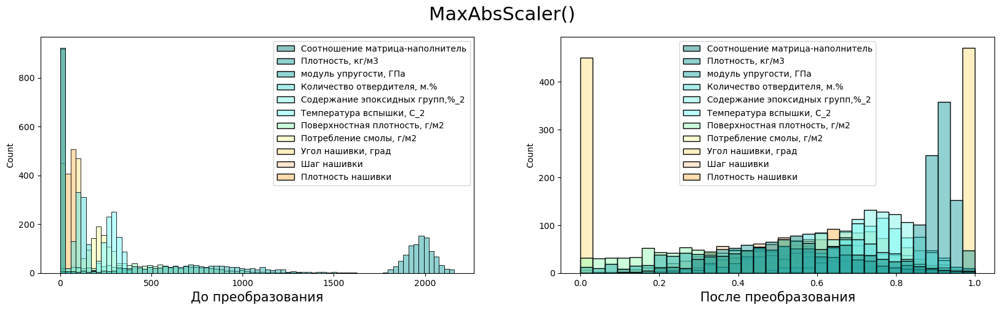

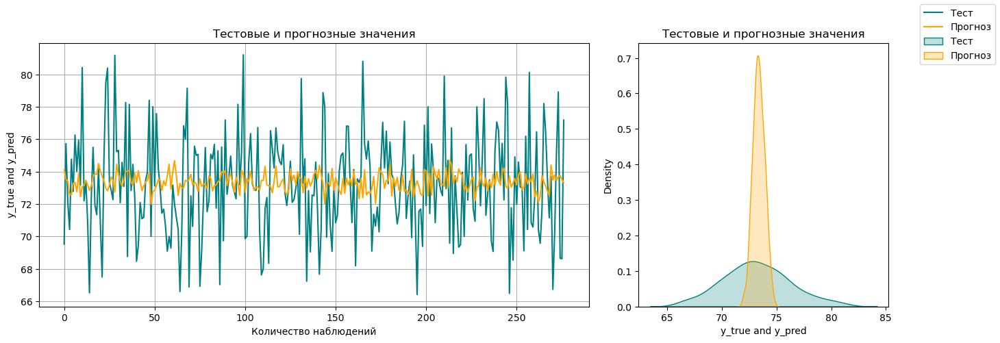

In [70]:
diagnostics(y_test, y_pred_rf[0], y_pred_rf[1])

#### Выведем метрики результатов предсказаний.

In [71]:
print_score(y_test, y_pred_rf[0], score_y1)

R2: -0.046
MSE: 9.891
RMSE: 3.145
MAE: 2.471
MAPE: 0.034


# SVR (Метод опорных векторов)
"Модуль упругости при растяжении, ГПа"

In [72]:
y_pred_svr = random_search(pipe_svr, svr_params)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
{'svr__kernel': 'sigmoid', 'svr__gamma': 1, 'svr__C': 1, 'scaler': MaxAbsScaler()}
-0.00571213083781652


Выведем сравнительную таблицу

In [73]:
comp_res(y_pred_svr[0])

,Actual,Predicted
69,69.53,73.40
420,75.73,73.40
180,72.15,73.40
681,70.43,73.40
972,74.77,73.40


Сравнительные графики.

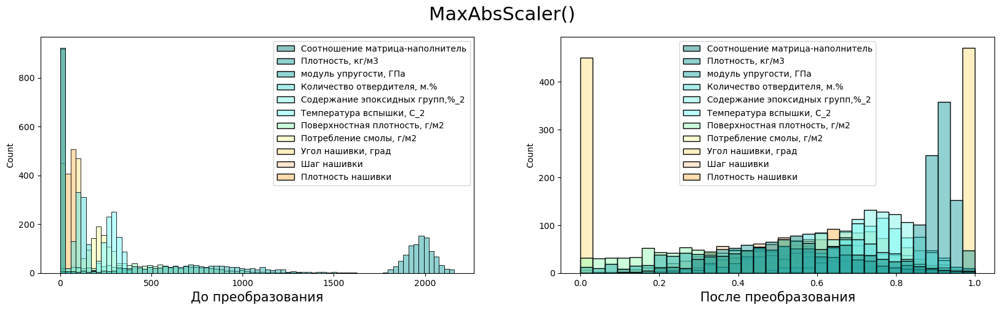

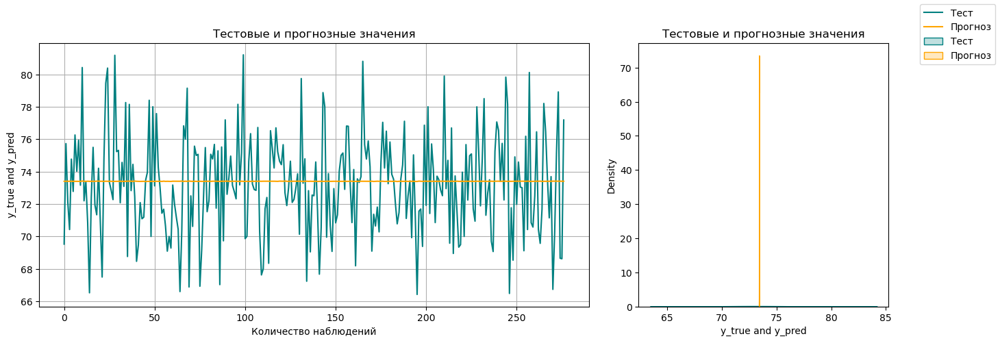

In [74]:
diagnostics(y_test, y_pred_svr[0], y_pred_svr[1])

В данном случае модель каждый раз предсказывает почти одинаковые значения.

Выведем метрики обучения модели.

In [75]:
print_score(y_test, y_pred_svr[0], score_y1)

R2: -0.006
MSE: 9.512
RMSE: 3.084
MAE: 2.459
MAPE: 0.034


# GradientBoostingRegressor (Градиентный бустинг)
"Модуль упругости при растяжении, ГПа"

In [76]:
y_pred_gbr = random_search(pipe_gbr, gbr_params)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
{'scaler': StandardScaler(), 'gbr__subsample': 0.2, 'gbr__n_estimators': 100, 'gbr__max_depth': 4, 'gbr__learning_rate': 0.02}
-0.05169328835704601


In [77]:
comp_res(y_pred_gbr[0])

,Actual,Predicted
69,69.53,74.00
420,75.73,73.51
180,72.15,73.87
681,70.43,71.90
972,74.77,72.28


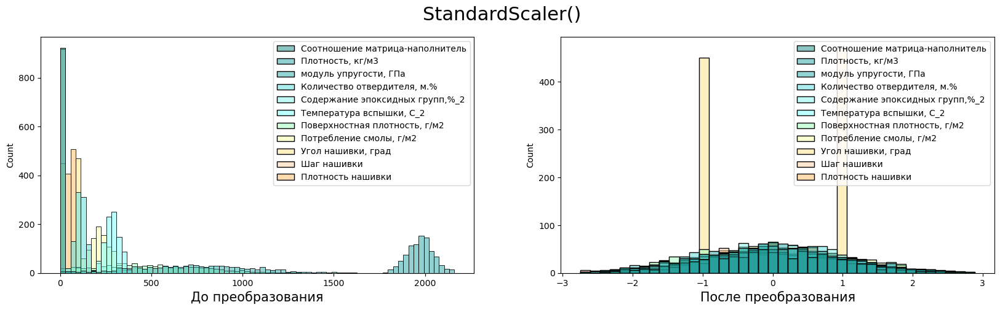

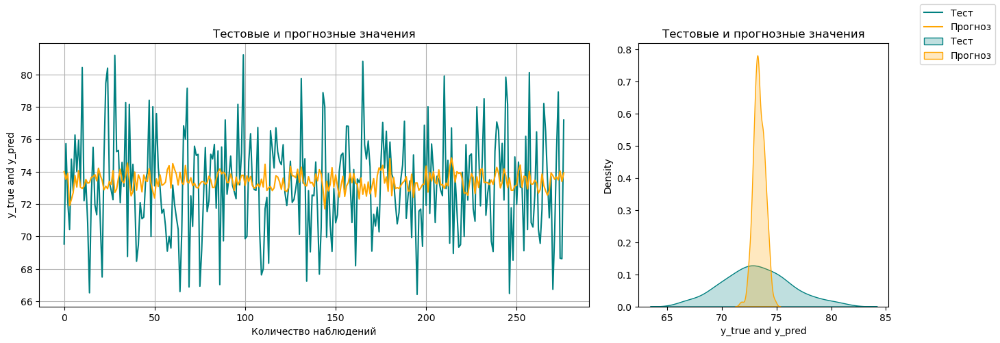

In [78]:
diagnostics(y_test, y_pred_gbr[0], y_pred_gbr[1])

In [79]:
print_score(y_test, y_pred_gbr[0], score_y1)

R2: -0.052
MSE: 9.946
RMSE: 3.154
MAE: 2.499
MAPE: 0.034


# Полносвязная нейронная сеть

### Напишем код для MinMaxScaler, StandardScaler, MaxAbsScaler, Robustscaler.
Применим данные методы перед подачи на обучение нейронной сети.

In [80]:
minmax = MinMaxScaler(feature_range=(0, 1))
minmax.fit(X_no_norm)
X_minmax = minmax.transform(X_no_norm)

In [81]:
stand_scal = StandardScaler()
stand_scal.fit(X_no_norm)
X_st_sc = stand_scal.transform(X_no_norm)

In [82]:
max_abs_sc = MaxAbsScaler()
max_abs_sc.fit(X_no_norm)
X_max_abs_sc = max_abs_sc.transform(X_no_norm)

In [83]:
robust_sc = RobustScaler()
robust_sc.fit(X_no_norm)
X_robust_sc = robust_sc.transform(X_no_norm)

### Функция разбивки на тренировочные и тестовые данные.

In [84]:
def train_test_spl(X, y):
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.3,
                                                    shuffle=True,
                                                    random_state=20)
    return X_train, X_test, y_train, y_test

### Функция создания нейронной сети.

In [85]:
def create_model(X_train, X_test, y_train, y_test):
    model = Sequential()
    model.add(Dense(128, activation='tanh', input_shape=(X_train.shape[1],)))
    model.add(Dropout(0.2))
    model.add(Dense(64, activation='tanh'))
    model.add(Dropout(0.2))
    model.add(Dense(1, activation='linear'))

    model.compile(optimizer=SGD(learning_rate=0.0001), loss='mse')

    history = model.fit(X_train, 
                    y_train,
                    batch_size=32,
                    epochs=30, 
                    validation_data=(X_test, y_test), 
                    verbose=0)

    # Отображаем графики ошибки обучения по обучающей выборке и по проверочной выборке на всех эпохах
    fig = plt.figure(figsize=(5, 3))
    plt.plot(history.history['loss'], label='Ошибка на обучающем наборе', color='teal')
    plt.plot(history.history['val_loss'], label='Ошибка на проверочном наборе', color='orange')
    plt.xlabel('Эпоха обучения')
    plt.ylabel('MSE')
    fig.legend()
    plt.show()
    return model

### Функция предсказания значения.

In [86]:
def y_pred(X_test, model): # Предсказываем тестовую выборку
    y_pred = model.predict(X_test)
    return y_pred

## MinMaxScaler для нейронной сети, предсказываем "Модуль упругости при растяжении, ГПа"

In [87]:
X_train, X_test, y_train, y_test = train_test_spl(X_minmax, y_1)[0], train_test_spl(X_minmax, y_1)[1], train_test_spl(X_minmax, y_1)[2], train_test_spl(X_minmax, y_1)[3]

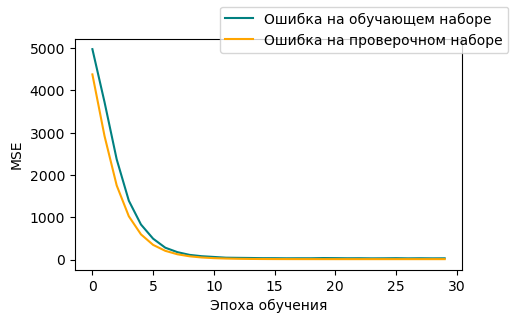

In [88]:
model_minmax_modul_elastic = create_model(X_train, X_test, y_train, y_test)
model_minmax_modul_elastic

In [89]:
y_pred_minmax_y1 = y_pred(X_test, model_minmax_modul_elastic)
y_pred_minmax_y1[:5]

9/9 [==============================] - 0s 2ms/step


array([[73.1995  ],
       [73.15336 ],
       [73.258606],
       [73.332535],
       [73.36674 ]], dtype=float32)

In [90]:
print_score(y_test, y_pred_minmax_y1, score_y1)

R2: 0.011
MSE: 9.732
RMSE: 3.12
MAE: 2.498
MAPE: 0.034


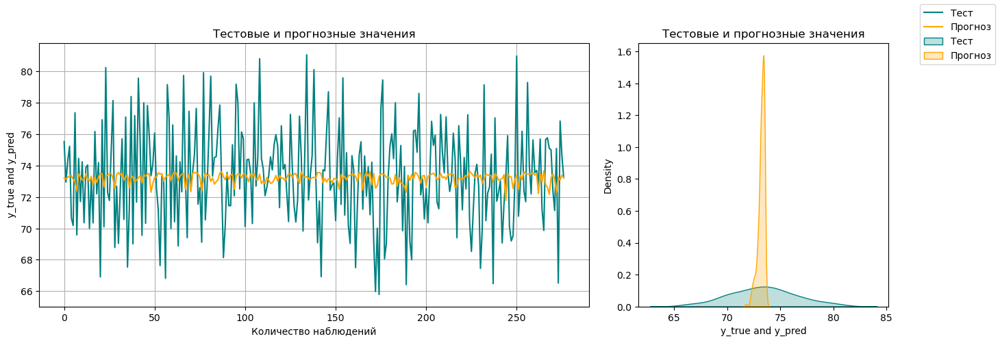

In [91]:
diagnostics_nn(y_test, y_pred_minmax_y1.reshape(-1, 1).flatten())

## StanderdScaler для нейронной сети, предсказываем "Модуль упругости при растяжении, ГПа"

In [92]:
X_train, X_test, y_train, y_test = train_test_spl(X_st_sc, y_1)[0], train_test_spl(X_st_sc, y_1)[1], train_test_spl(X_st_sc, y_1)[2], train_test_spl(X_st_sc, y_1)[3]


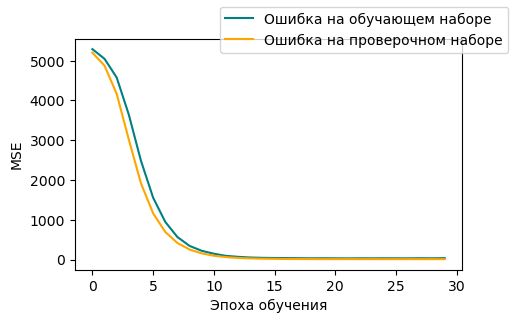

In [93]:
model_st_scal_modul_elastic = create_model(X_train, X_test, y_train, y_test)

In [94]:
y_pred_st_scal_y1 = y_pred(X_test, model_st_scal_modul_elastic)
y_pred_st_scal_y1[:5]

9/9 [==============================] - 0s 2ms/step


array([[72.976166],
       [73.09203 ],
       [73.30851 ],
       [72.88214 ],
       [73.01115 ]], dtype=float32)

In [95]:
print_score(y_test, y_pred_st_scal_y1, score_y1)

R2: -0.017
MSE: 10.006
RMSE: 3.163
MAE: 2.516
MAPE: 0.034


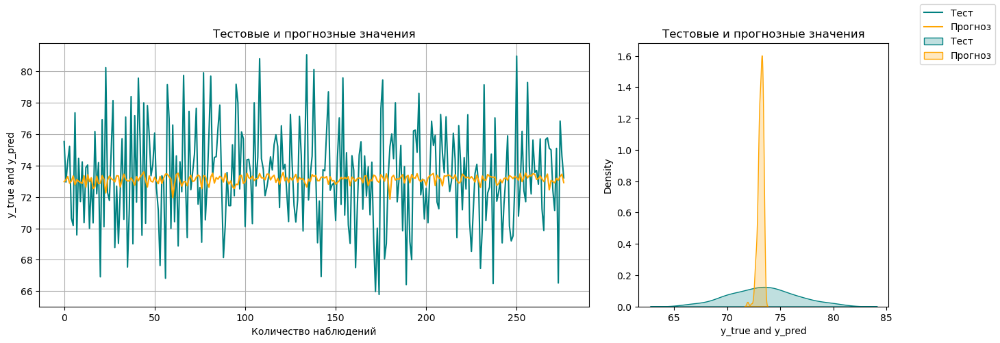

In [96]:
diagnostics_nn(y_test, y_pred_st_scal_y1.reshape(-1, 1).flatten())

## MaxAbsScaler для нейронной сети, предсказываем "Модуль упругости при растяжении, ГПа"

In [97]:
X_train, X_test, y_train, y_test = train_test_spl(X_max_abs_sc, y_1)[0], train_test_spl(X_max_abs_sc, y_1)[1], train_test_spl(X_max_abs_sc, y_1)[2], train_test_spl(X_max_abs_sc, y_1)[3]


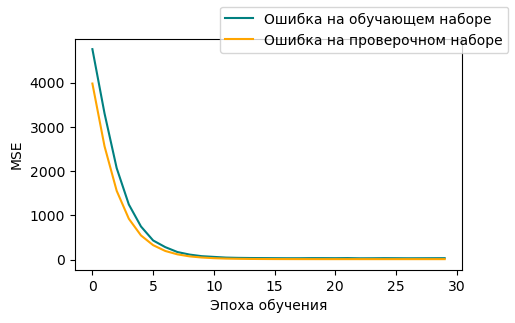

In [98]:
model_max_abs_sc_modul_elastic = create_model(X_train, X_test, y_train, y_test)

In [99]:
y_pred_max_abs_sc_y1 = y_pred(X_test, model_max_abs_sc_modul_elastic)
y_pred_max_abs_sc_y1[:5]

9/9 [==============================] - 0s 2ms/step


array([[73.10095],
       [73.10178],
       [73.11035],
       [73.14046],
       [73.14654]], dtype=float32)

In [100]:
print_score(y_test, y_pred_max_abs_sc_y1, score_y1)

R2: 0.001
MSE: 9.826
RMSE: 3.135
MAE: 2.506
MAPE: 0.034


## RobustScaler для нейронной сети, предсказываем "Модуль упругости при растяжении, ГПа"

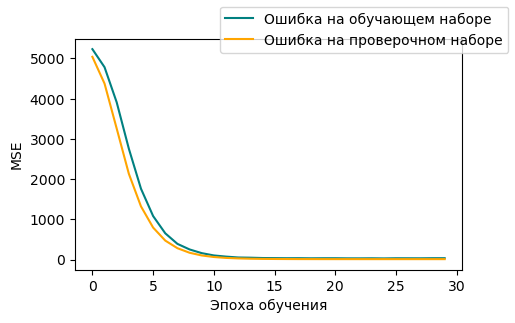

In [101]:
X_train, X_test, y_train, y_test = train_test_spl(X_robust_sc, y_1)[0], train_test_spl(X_robust_sc, y_1)[1], train_test_spl(X_robust_sc, y_1)[2], train_test_spl(X_robust_sc, y_1)[3]
model_robust_sc_modul_elastic = create_model(X_train, X_test, y_train, y_test)


In [102]:
y_pred_robust_sc_y1 = y_pred(X_test, model_robust_sc_modul_elastic)
y_pred_robust_sc_y1[:5]

9/9 [==============================] - 0s 2ms/step


array([[71.97333 ],
       [72.57015 ],
       [73.875885],
       [73.77293 ],
       [73.83593 ]], dtype=float32)

In [103]:
print_score(y_test, y_pred_robust_sc_y1, score_y1)

R2: -0.081
MSE: 10.629
RMSE: 3.26
MAE: 2.585
MAPE: 0.035


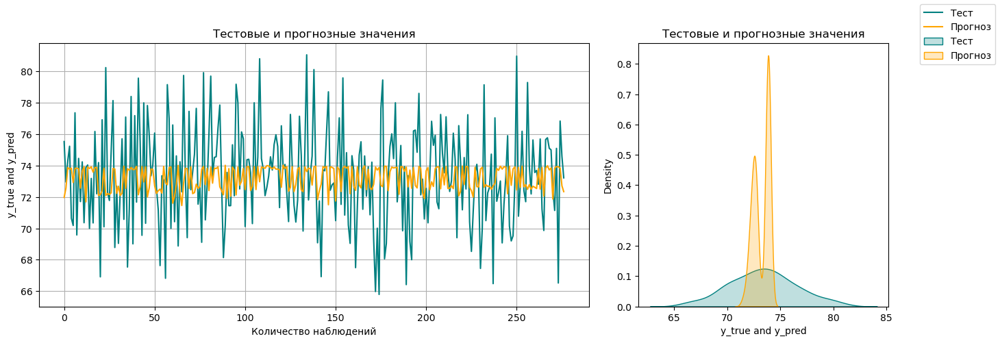

In [104]:
diagnostics_nn(y_test, y_pred_robust_sc_y1.reshape(-1, 1).flatten())

### Сохраним модель

In [105]:
pickle.dump(minmax, open('./models/minmax.pkl', 'wb'))

In [106]:
model_minmax_modul_elastic.save('./models/modul_elastic')

INFO:tensorflow:Assets written to: ./models/modul_elastic\assets


INFO:tensorflow:Assets written to: ./models/modul_elastic\assets


### Выведем таблицу метрик, оценивающих работу наших моделей

In [107]:
df_score_y1 = pd.DataFrame(np.array(score_y1).reshape(9,5), columns=('R2', 'MSE', 'RMSE', 'MAE', 'MAPE'))
df_score_y1.insert(0, 'Model_regr', ['LinearRegression', 'KNeighborsRegressor', 'RandomForestRegressor', 'SVR', 'GradientBoostingRegressor', 'Neural_net_minmax', 'Neural_net_stand_scal', 'Neural_net_max_abs_scal', 'Neural_net_robust_sc'], True)
df_score_y1.set_index('Model_regr', inplace=True)
# сохраним таблицу
df_score_y1.to_excel('df_score_y1.xlsx')
print('Модуль упругости при растяжении, ГПа')
df_score_y1

Модуль упругости при растяжении, ГПа


,R2,MSE,RMSE,MAE,MAPE
Model_regr,,,,,
LinearRegression,-0.03,9.71,3.12,2.48,0.03
KNeighborsRegressor,-0.01,9.57,3.09,2.48,0.03
RandomForestRegressor,-0.05,9.89,3.15,2.47,0.03
SVR,-0.01,9.51,3.08,2.46,0.03
GradientBoostingRegressor,-0.05,9.95,3.15,2.50,0.03
Neural_net_minmax,0.01,9.73,3.12,2.50,0.03
Neural_net_stand_scal,-0.02,10.01,3.16,2.52,0.03
Neural_net_max_abs_scal,0.00,9.83,3.13,2.51,0.03
Neural_net_robust_sc,-0.08,10.63,3.26,2.58,0.04


# Предсказываем 'Прочность при растяжении, МПа'

Разобьем данные на обучающую и тестовую выборки

In [108]:
X_train, X_test, y_train, y_test = train_test_split(X_no_norm, y_2,
                                                    test_size=0.3,
                                                    shuffle=True,
                                                    random_state=18)

In [109]:
# размерность обучающей
print(X_train.shape, y_train.shape)

# и тестовой выборки
print(X_test.shape, y_test.shape)

(645, 11) (645,)
(277, 11) (277,)


# LinearRegression 
"Прочность при растяжении, МПа"

In [110]:
y_pred_lr = grid_search(pipe_lr, linreg_params)

{'lr__fit_intercept': 'True', 'scaler': MinMaxScaler()}
-0.014821905358583853


Построим сравнительную таблицу

In [111]:
comp_res(y_pred_lr[0])

,Actual,Predicted
69,2164.39,2429.27
420,2052.93,2390.30
180,1680.97,2460.33
681,2181.81,2354.16
972,3375.20,2320.27


Построим сравнительные графики

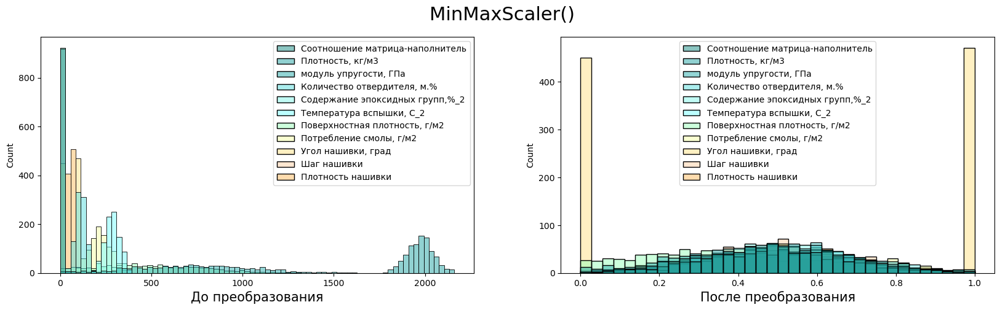

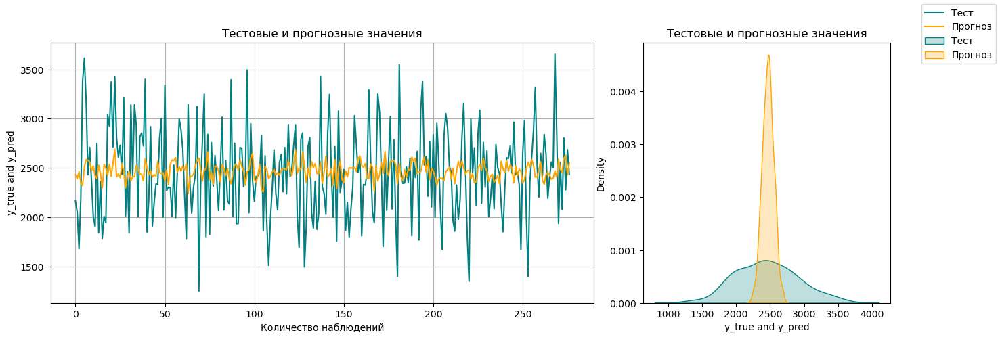

In [112]:
diagnostics(y_test, y_pred_lr[0], y_pred_lr[1])

In [113]:
print_score(y_test, y_pred_lr[0], score_y2)

R2: -0.015
MSE: 214500.174
RMSE: 463.142
MAE: 372.068
MAPE: 0.162


# KNeighborsRegressor (метод ближайших соседей)
"Прочность при растяжении, МПа"

In [114]:
y_pred_rnn = grid_search(pipe_knn, knn_params)

{'knn__algorithm': 'auto', 'knn__n_neighbors': 47, 'knn__weights': 'uniform', 'scaler': MaxAbsScaler()}
0.006789149317663834


Предскажем и выведем 5 предсказанных значений

In [115]:
comp_res(y_pred_rnn[0])

,Actual,Predicted
69,2164.39,2542.92
420,2052.93,2413.43
180,1680.97,2430.98
681,2181.81,2503.15
972,3375.20,2430.08


Выведем сравнительные графики

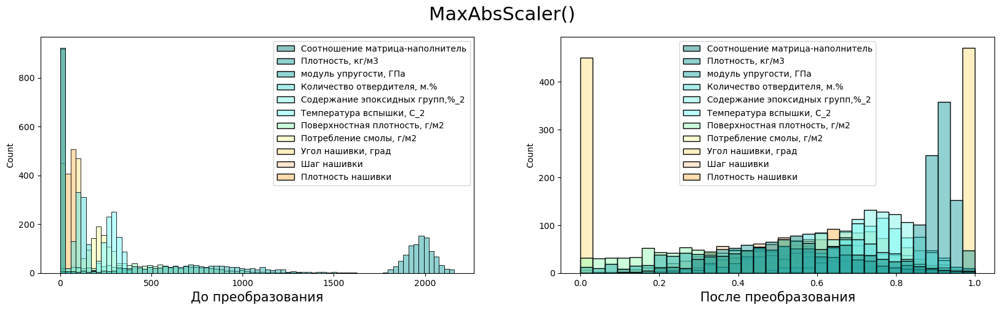

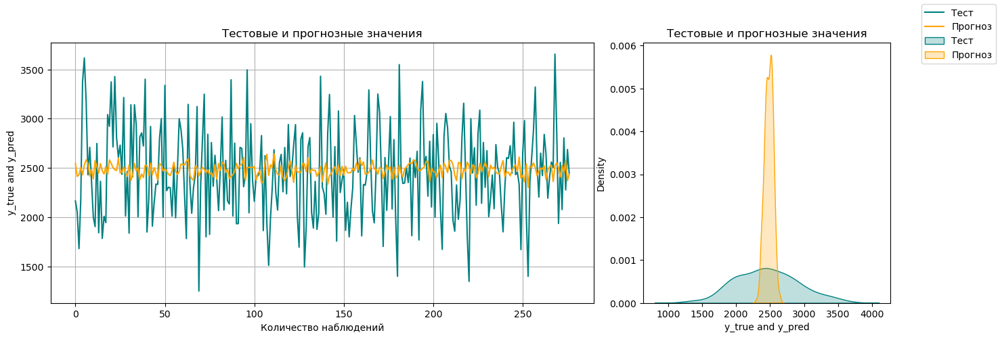

In [116]:
diagnostics(y_test, y_pred_rnn[0], y_pred_rnn[1])

In [117]:
print_score(y_test, y_pred_rnn[0], score_y2)

R2: 0.007
MSE: 209932.304
RMSE: 458.184
MAE: 369.541
MAPE: 0.161


# Random Forest
"Прочность при растяжении, МПа"

Случайный поиск гиперпараметров

In [118]:
y_pred_rf = random_search(pipe_rf, rf_params)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
{'scaler': MinMaxScaler(), 'rf__n_estimators': 490, 'rf__max_features': 'sqrt', 'rf__max_depth': 61, 'rf__criterion': 'squared_error'}
-0.002452832914867198


Предскажем значения и выведем на экран первые 5.

In [119]:
comp_res(y_pred_rf[0])

,Actual,Predicted
69,2164.39,2410.47
420,2052.93,2453.03
180,1680.97,2313.03
681,2181.81,2541.59
972,3375.20,2313.85


Сравнительные графики

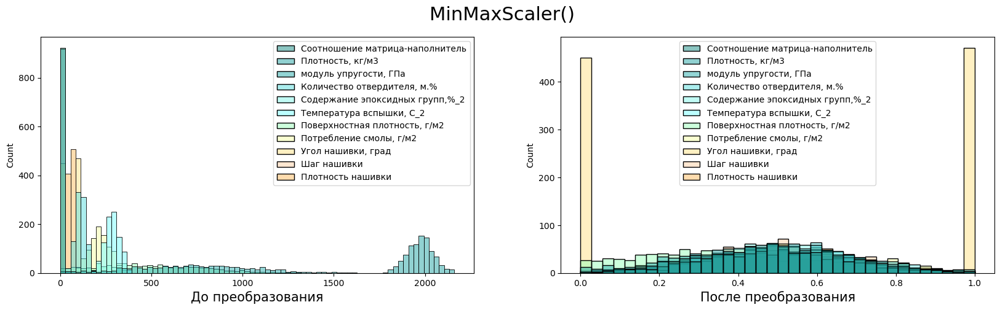

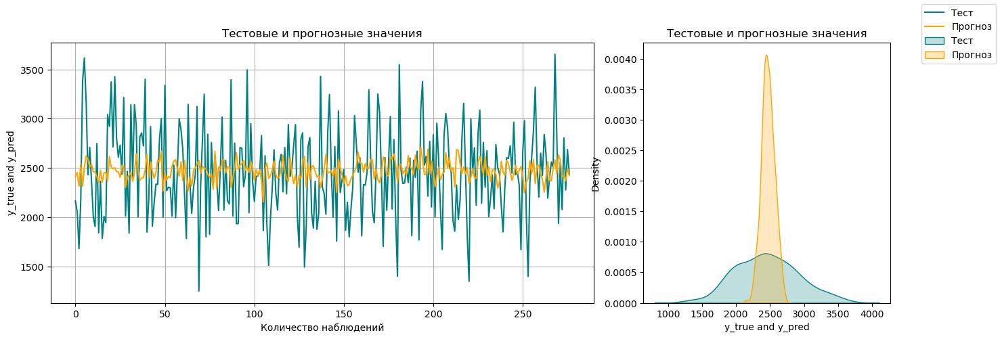

In [120]:
diagnostics(y_test, y_pred_rf[0], y_pred_rf[1])

Оценка модели

In [121]:
print_score(y_test, y_pred_rf[0], score_y2)

R2: -0.002
MSE: 211885.757
RMSE: 460.311
MAE: 369.991
MAPE: 0.161


Сохраним модель

In [122]:
best_estimator = y_pred_rf[2]

# SVR (Метод опорных векторов)
"Прочность при растяжении, МПа"

Случайный подбор гиперпараметров

In [123]:
y_pred_svr = random_search(pipe_svr, svr_params)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
{'svr__kernel': 'sigmoid', 'svr__gamma': 0.01, 'svr__C': 41, 'scaler': RobustScaler()}
0.0013613777431288332


Предскажем значения и выведем на экран первые 5.

In [124]:
comp_res(y_pred_svr[0])

,Actual,Predicted
69,2164.39,2457.64
420,2052.93,2457.41
180,1680.97,2465.76
681,2181.81,2446.25
972,3375.20,2443.48


Выведем сравнительную таблицу

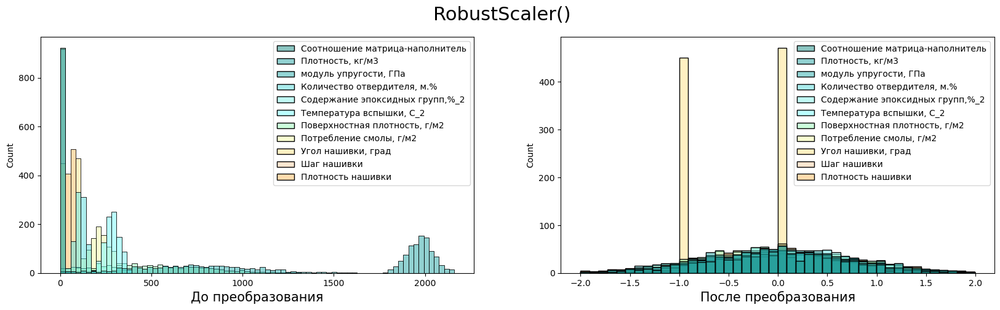

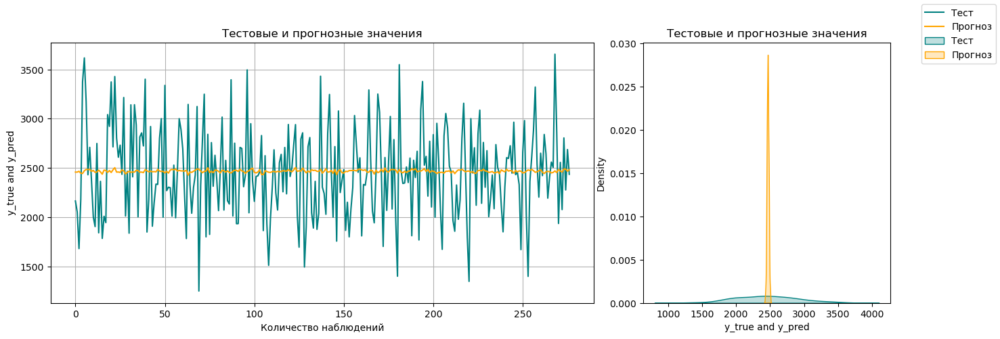

In [125]:
diagnostics(y_test, y_pred_svr[0], y_pred_svr[1])

Сравнительные графики

In [126]:
print_score(y_test, y_pred_svr[0], score_y2)

R2: 0.001
MSE: 211079.557
RMSE: 459.434
MAE: 370.153
MAPE: 0.161


# GradientBoostingRegressor (Градиентный бустинг)
"Прочность при растяжении, МПа"

In [127]:
y_pred_gbr = random_search(pipe_gbr, gbr_params)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
{'scaler': StandardScaler(), 'gbr__subsample': 0.2, 'gbr__n_estimators': 100, 'gbr__max_depth': 4, 'gbr__learning_rate': 0.02}
-0.019455391876648243


In [128]:
comp_res(y_pred_gbr[0])

,Actual,Predicted
69,2164.39,2474.03
420,2052.93,2425.73
180,1680.97,2323.59
681,2181.81,2438.70
972,3375.20,2277.35


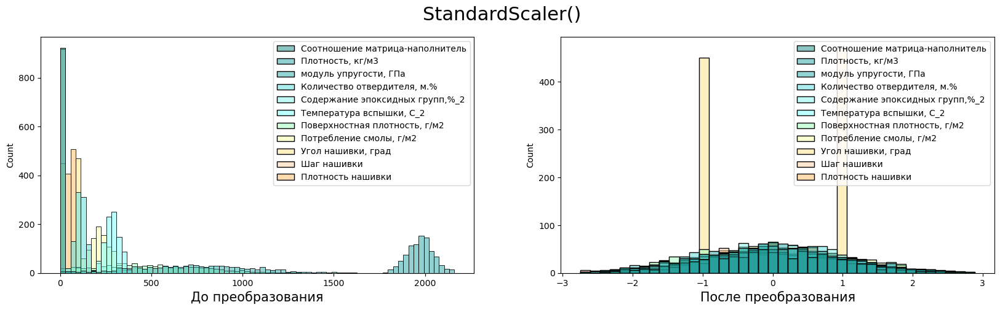

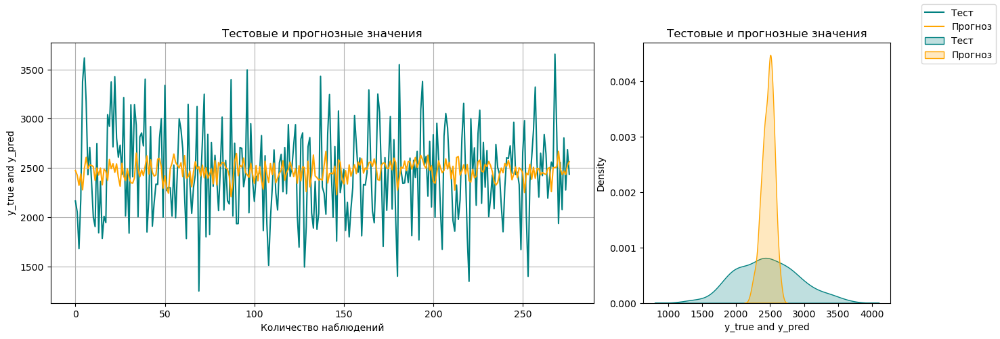

In [129]:
diagnostics(y_test, y_pred_gbr[0], y_pred_gbr[1])

In [130]:
print_score(y_test, y_pred_gbr[0], score_y2)

R2: -0.019
MSE: 215479.542
RMSE: 464.198
MAE: 370.861
MAPE: 0.161


# Полносвязная нейронная сеть

## MinMaxScaler для нейронной сети, предсказываем "Прочность при растяжении, МПа"

In [131]:
X_train, X_test, y_train, y_test = train_test_spl(X_minmax, y_2)[0], train_test_spl(X_minmax, y_2)[1], train_test_spl(X_minmax, y_2)[2], train_test_spl(X_minmax, y_2)[3]

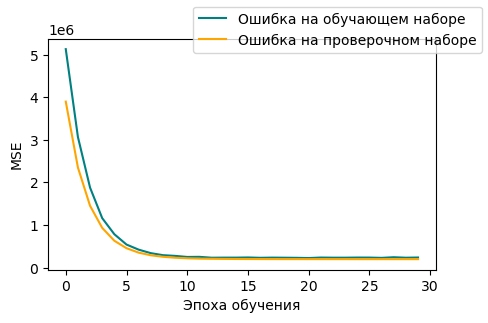

In [132]:
model_minmax_tensile_strength = create_model(X_train, X_test, y_train, y_test)
model_minmax_tensile_strength

In [133]:
y_pred_minmax_y2 = y_pred(X_test, model_minmax_tensile_strength)
y_pred_minmax_y2[:5]

9/9 [==============================] - 0s 2ms/step


array([[2444.1155],
       [2444.1165],
       [2444.119 ],
       [2444.1194],
       [2444.1194]], dtype=float32)

In [134]:
print_score(y_test, y_pred_minmax_y2, score_y2)

R2: -0.005
MSE: 198898.015
RMSE: 445.98
MAE: 360.346
MAPE: 0.152


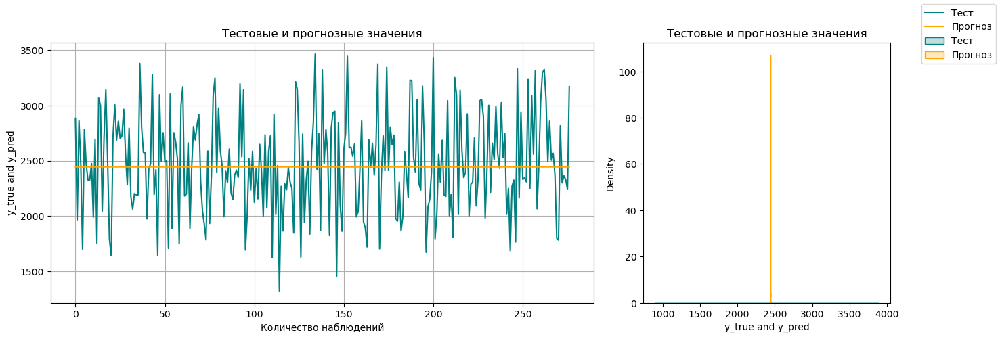

In [135]:
diagnostics_nn(y_test, y_pred_minmax_y2.flatten())

## StandardScaler для нейронной сети, предсказываем "Прочность при растяжении, МПа"

In [136]:
X_train, X_test, y_train, y_test = train_test_spl(X_st_sc, y_2)[0], train_test_spl(X_st_sc, y_2)[1], train_test_spl(X_st_sc, y_2)[2], train_test_spl(X_st_sc, y_2)[3]


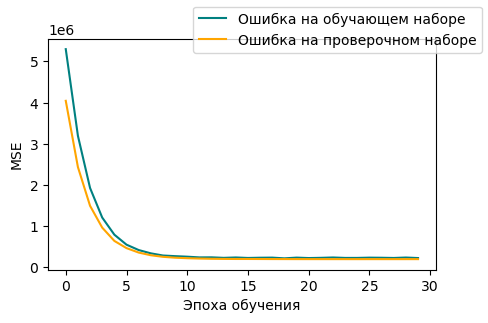

In [137]:
model_st_scal_tensile_strength = create_model(X_train, X_test, y_train, y_test)

In [138]:
y_pred_st_scal_y2 = y_pred(X_test, model_st_scal_tensile_strength)
y_pred_st_scal_y2[:5]

9/9 [==============================] - 0s 2ms/step


array([[2448.9565],
       [2448.9631],
       [2448.96  ],
       [2448.9531],
       [2448.9539]], dtype=float32)

In [139]:
print_score(y_test, y_pred_st_scal_y2, score_y2)

R2: -0.003
MSE: 198625.415
RMSE: 445.674
MAE: 360.293
MAPE: 0.153


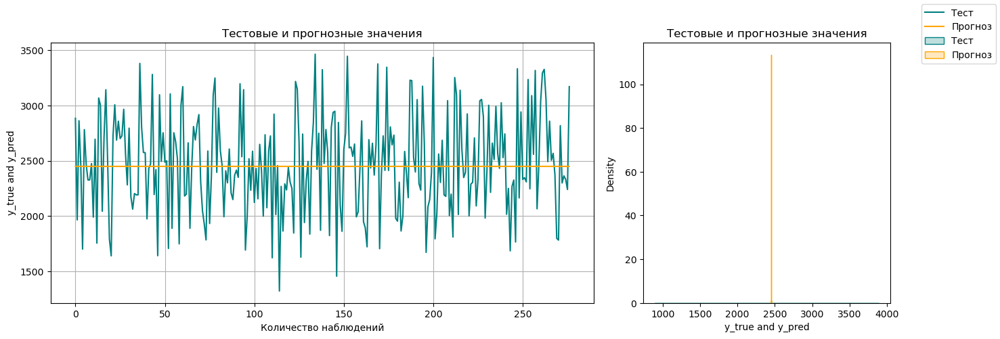

In [140]:
diagnostics_nn(y_test, y_pred_st_scal_y2.reshape(-1, 1).flatten())

## MaxAbsScaler для нейронной сети, предсказываем "Прочность при растяжении, МПа"

In [141]:
X_train, X_test, y_train, y_test = train_test_spl(X_max_abs_sc, y_2)[0], train_test_spl(X_max_abs_sc, y_2)[1], train_test_spl(X_max_abs_sc, y_2)[2], train_test_spl(X_max_abs_sc, y_2)[3]


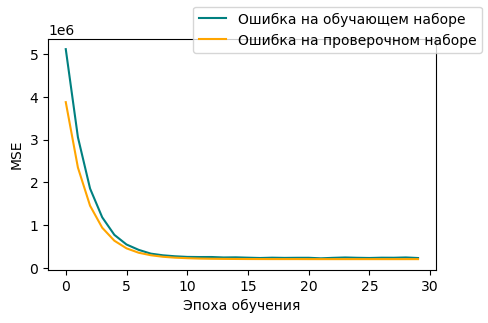

In [142]:
model_max_abs_sc_tensile_strength = create_model(X_train, X_test, y_train, y_test)

In [143]:
y_pred_max_abs_sc_y2 = y_pred(X_test, model_max_abs_sc_tensile_strength)
y_pred_max_abs_sc_y2[:5]

9/9 [==============================] - 0s 0s/step


array([[2444.8538],
       [2444.8533],
       [2444.8545],
       [2444.8555],
       [2444.856 ]], dtype=float32)

In [144]:
print_score(y_test, y_pred_max_abs_sc_y2, score_y2)

R2: -0.004
MSE: 198853.301
RMSE: 445.93
MAE: 360.338
MAPE: 0.152


## RobustScaler для нейронной сети, предсказываем "Прочность при растяжении, МПа"

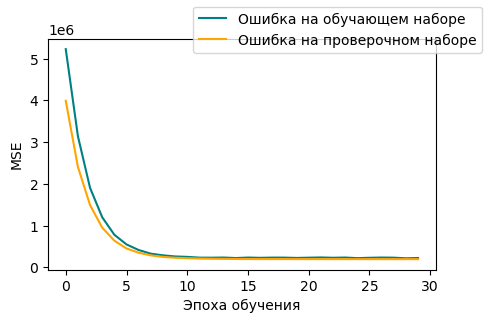

In [145]:
X_train, X_test, y_train, y_test = train_test_spl(X_robust_sc, y_2)[0], train_test_spl(X_robust_sc, y_2)[1], train_test_spl(X_robust_sc, y_2)[2], train_test_spl(X_robust_sc, y_2)[3]
model_robust_sc_tensile_strength = create_model(X_train, X_test, y_train, y_test)


In [146]:
y_pred_robust_sc_y2 = y_pred(X_test, model_robust_sc_tensile_strength)
y_pred_robust_sc_y2[:5]

9/9 [==============================] - 0s 1ms/step


array([[2449.3628],
       [2449.3828],
       [2449.3953],
       [2449.3943],
       [2449.3945]], dtype=float32)

In [147]:
print_score(y_test, y_pred_robust_sc_y2, score_y2)

R2: -0.003
MSE: 198603.229
RMSE: 445.649
MAE: 360.288
MAPE: 0.153


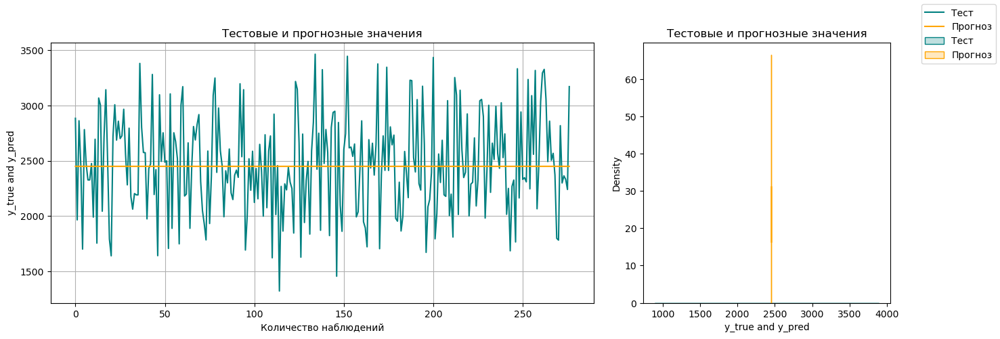

In [148]:
diagnostics_nn(y_test, y_pred_robust_sc_y2.reshape(-1, 1).flatten())

In [149]:
df_score_y2 = pd.DataFrame(np.array(score_y2).reshape(9,5), columns=('R2', 'MSE', 'RMSE', 'MAE', 'MAPE'))
df_score_y2.insert(0, 'Model_regr', ['LinearRegression', 'KNeighborsRegressor', 'RandomForestRegressor', 'SVR', 'GradientBoostingRegressor', 'Neural_net_minmax', 'Neural_net_stand_scal', 'Neural_net_max_abs_scal', 'Neural_net_robust_sc'], True)
df_score_y2.set_index('Model_regr', inplace=True)
# сохраним таблицу
df_score_y2.to_excel('df_score_y2.xlsx')
print('Модуль упругости при растяжении, ГПа')
df_score_y2

Модуль упругости при растяжении, ГПа


,R2,MSE,RMSE,MAE,MAPE
Model_regr,,,,,
LinearRegression,-0.01,214500.17,463.14,372.07,0.16
KNeighborsRegressor,0.01,209932.30,458.18,369.54,0.16
RandomForestRegressor,-0.00,211885.76,460.31,369.99,0.16
SVR,0.00,211079.56,459.43,370.15,0.16
GradientBoostingRegressor,-0.02,215479.54,464.20,370.86,0.16
Neural_net_minmax,-0.00,198898.01,445.98,360.35,0.15
Neural_net_stand_scal,-0.00,198625.42,445.67,360.29,0.15
Neural_net_max_abs_scal,-0.00,198853.30,445.93,360.34,0.15
Neural_net_robust_sc,-0.00,198603.23,445.65,360.29,0.15


### Выведем таблицу метрик, оценивающих работу наших моделей

### Сохраним модель

In [170]:
model_robust_sc_tensile_strength.save('./models/tensile_strength')

INFO:tensorflow:Assets written to: ./models/tensile_strength\assets


INFO:tensorflow:Assets written to: ./models/tensile_strength\assets


In [172]:
pickle.dump(robust_sc, open('./models/robust_sc.pkl', 'wb'))

# Напишем нейронную сеть и предскажем соотношение "Матрица - наполнитель"

In [151]:
X_no_norm = data[['Плотность, кг/м3',
                  'модуль упругости, ГПа', 'Количество отвердителя, м.%',
                  'Содержание эпоксидных групп,%_2', 'Температура вспышки, С_2',
                  'Поверхностная плотность, г/м2', 'Модуль упругости при растяжении, ГПа',
                  'Прочность при растяжении, МПа', 'Потребление смолы, г/м2',
                  'Угол нашивки, град', 'Шаг нашивки', 'Плотность нашивки']]
y = data['Соотношение матрица-наполнитель']

In [152]:
X_no_norm.shape, y.shape

((922, 12), (922,))

## MinMaxScaler

In [153]:
minmax_matrix_filler = MinMaxScaler()
# применим метод MinMaxScaler к данным.
minmax_matrix_filler.fit(X_no_norm)

MinMaxScaler()

### Сохраним преобразователь MinMaxScaler.
Он нам пригодится при написании программы по предсказанию значения "Соотношение матрица-наполнитель".

In [154]:
pickle.dump(minmax_matrix_filler, open('./models/minmax_matrix_filler.pkl', 'wb'))

### Проверим работоспособность MinMaxScaler:

In [155]:
minmax_load_matr = pickle.load(open('./models/minmax_matrix_filler.pkl', 'rb'))
minmax_load_matr = minmax_load_matr.transform(X_no_norm)
print(minmax_load_matr[:3])

[[0.65109743 0.4529507  0.07915272 0.60743528 0.50916426 0.16223008
  0.27296208 0.72777743 0.5146881  0.         0.28933398 0.54643302]
 [0.65109743 0.4529507  0.63098305 0.41888696 0.58359624 0.16223008
  0.27296208 0.72777743 0.5146881  0.         0.36235459 0.31975787]
 [0.65109743 0.46172498 0.51125682 0.49565306 0.50916426 0.16223008
  0.27296208 0.72777743 0.5146881  0.         0.36235459 0.49412337]]


In [156]:
X = minmax_matrix_filler.transform(X_no_norm)
print(X[:3])

[[0.65109743 0.4529507  0.07915272 0.60743528 0.50916426 0.16223008
  0.27296208 0.72777743 0.5146881  0.         0.28933398 0.54643302]
 [0.65109743 0.4529507  0.63098305 0.41888696 0.58359624 0.16223008
  0.27296208 0.72777743 0.5146881  0.         0.36235459 0.31975787]
 [0.65109743 0.46172498 0.51125682 0.49565306 0.50916426 0.16223008
  0.27296208 0.72777743 0.5146881  0.         0.36235459 0.49412337]]


### Разобьем данные на тестовую и обучающую выборку.

In [157]:
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.3,
                                                    shuffle=True,
                                                    random_state=18)

In [158]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((645, 12), (645,), (277, 12), (277,))

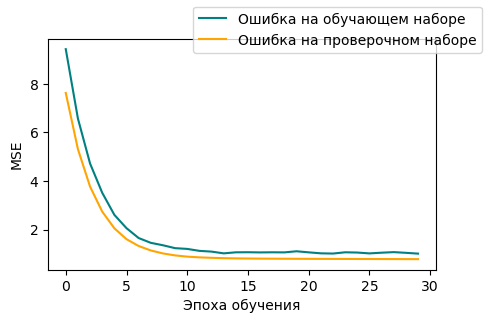

In [159]:
# Создаём сеть
model_matrix_filler = Sequential()
model_matrix_filler.add(Dense(128, activation='tanh', input_shape=(X_train.shape[1],)))
model_matrix_filler.add(Dropout(0.2))
model_matrix_filler.add(Dense(64, activation='tanh'))
model_matrix_filler.add(Dropout(0.2))
model_matrix_filler.add(Dense(1, activation='linear'))

model_matrix_filler.compile(optimizer=SGD(learning_rate=0.0001), loss='mse')

history_matrix_filler = model_matrix_filler.fit(X_train, 
                    y_train,
                    batch_size=15,
                    epochs=30, 
                    validation_data=(X_test, y_test), 
                    verbose=0)

# Отображаем графики ошибки обучения по обучающей выборке и по проверочной выборке на всех эпохах
fig = plt.figure(figsize=(5, 3))
plt.plot(history_matrix_filler.history['loss'], label='Ошибка на обучающем наборе', color='teal')
plt.plot(history_matrix_filler.history['val_loss'], label='Ошибка на проверочном наборе', color='orange')
plt.xlabel('Эпоха обучения')
plt.ylabel('MSE')
fig.legend()
plt.show()

In [160]:
print(model_matrix_filler.summary())

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_24 (Dense)            (None, 128)               1664      
                                                                 
 dropout_16 (Dropout)        (None, 128)               0         
                                                                 
 dense_25 (Dense)            (None, 64)                8256      
                                                                 
 dropout_17 (Dropout)        (None, 64)                0         
                                                                 
 dense_26 (Dense)            (None, 1)                 65        
                                                                 
Total params: 9,985
Trainable params: 9,985
Non-trainable params: 0
_________________________________________________________________
None


In [161]:
y_pred_matrix_filler = y_pred(X_test, model_matrix_filler)

9/9 [==============================] - 0s 2ms/step


In [162]:
comp_res = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred_matrix_filler.flatten()}) 
comp_res.head()

,Actual,Predicted
69,3.12,2.32
420,3.64,2.97
180,2.99,2.48
681,3.89,3.21
972,1.00,3.29


In [163]:
print_score(y_test, y_pred_matrix_filler, [])

R2: -0.139
MSE: 0.783
RMSE: 0.885
MAE: 0.718
MAPE: 0.292


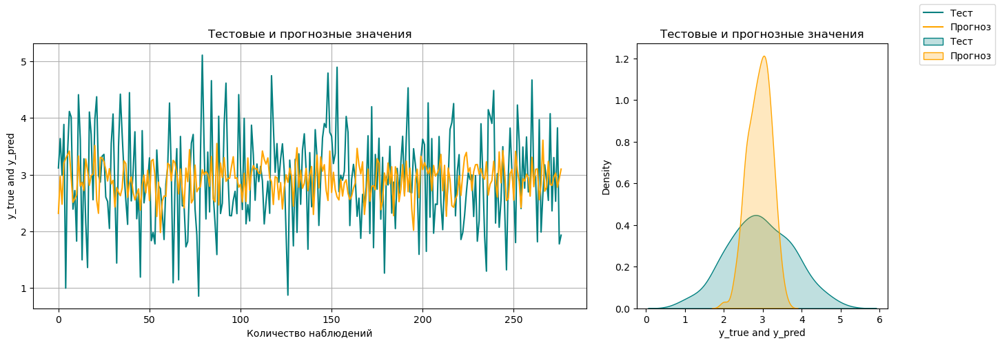

In [164]:
diagnostics_nn(y_test, y_pred_matrix_filler.flatten())

### Сохраним модель

In [165]:
model_matrix_filler.save('./models/matrix_filler')

INFO:tensorflow:Assets written to: ./models/matrix_filler\assets


INFO:tensorflow:Assets written to: ./models/matrix_filler\assets


# Посмотрим на метрики и оценим, какой алгоритм является лучшим для решения нашей задачи.

## 'Модуль упругости при растяжении, ГПа'       

In [166]:
modul_elastic_score = pd.read_excel('df_score_y1.xlsx', index_col=False)
modul_elastic_score

,Model_regr,R2,MSE,RMSE,MAE,MAPE
0,LinearRegression,-0.03,9.71,3.12,2.48,0.03
1,KNeighborsRegressor,-0.01,9.57,3.09,2.48,0.03
2,RandomForestRegressor,-0.05,9.89,3.15,2.47,0.03
3,SVR,-0.01,9.51,3.08,2.46,0.03
4,GradientBoostingRegressor,-0.05,9.95,3.15,2.50,0.03
5,Neural_net_minmax,0.01,9.73,3.12,2.50,0.03
6,Neural_net_stand_scal,-0.02,10.01,3.16,2.52,0.03
7,Neural_net_max_abs_scal,0.00,9.83,3.13,2.51,0.03
8,Neural_net_robust_sc,-0.08,10.63,3.26,2.58,0.04


In [167]:
print('Лучший показатель R2 =', max(modul_elastic_score['R2']), 'в модели', modul_elastic_score['Model_regr'][modul_elastic_score['R2'].idxmax()])
print('Лучший показатель MSE =', min(modul_elastic_score['MSE']), 'в модели', modul_elastic_score['Model_regr'][modul_elastic_score['MSE'].idxmin()])
print('Лучший показатель MAE =', min(modul_elastic_score['MAE']), 'в модели', modul_elastic_score['Model_regr'][modul_elastic_score['MAE'].idxmin()])

Лучший показатель R2 = 0.0107 в модели Neural_net_minmax
Лучший показатель MSE = 9.5116 в модели SVR
Лучший показатель MAE = 2.4591 в модели SVR


## 'Прочность при растяжении, МПа'

In [168]:
tensile_strength_score = pd.read_excel('df_score_y2.xlsx')
tensile_strength_score

,Model_regr,R2,MSE,RMSE,MAE,MAPE
0,LinearRegression,-0.01,214500.17,463.14,372.07,0.16
1,KNeighborsRegressor,0.01,209932.30,458.18,369.54,0.16
2,RandomForestRegressor,-0.00,211885.76,460.31,369.99,0.16
3,SVR,0.00,211079.56,459.43,370.15,0.16
4,GradientBoostingRegressor,-0.02,215479.54,464.20,370.86,0.16
5,Neural_net_minmax,-0.00,198898.01,445.98,360.35,0.15
6,Neural_net_stand_scal,-0.00,198625.42,445.67,360.29,0.15
7,Neural_net_max_abs_scal,-0.00,198853.30,445.93,360.34,0.15
8,Neural_net_robust_sc,-0.00,198603.23,445.65,360.29,0.15


In [169]:
print('Лучший показатель R2 =', max(tensile_strength_score['R2']), 'в модели', tensile_strength_score['Model_regr'][tensile_strength_score['R2'].idxmax()])
print('Лучший показатель MSE =', min(tensile_strength_score['MSE']), 'в модели', tensile_strength_score['Model_regr'][tensile_strength_score['MSE'].idxmin()])
print('Лучший показатель MAE =', min(tensile_strength_score['MAE']), 'в модели', tensile_strength_score['Model_regr'][tensile_strength_score['MAE'].idxmin()])

Лучший показатель R2 = 0.0068 в модели KNeighborsRegressor
Лучший показатель MSE = 198603.2294 в модели Neural_net_robust_sc
Лучший показатель MAE = 360.2882 в модели Neural_net_robust_sc
